<a href="https://colab.research.google.com/github/Santosh2Argade/Optimal_Portfolio_Construction_using_Markowitz/blob/main/Optimal_Portfolio_Construction_using_Markowitz.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
import pandas as pd
import numpy as np
from pandas import Series, DataFrame
from datetime import datetime

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading Dataset

In [12]:
data = pd.read_csv('/content/drive/MyDrive/ML Projects/Optimal Portfolio Construction using Markowitz/NSE_top_100_companies_five_years_daily_stock_closing_price_data.csv')

In [13]:
data.shape

(1281, 102)

In [14]:
data.head()

,Date,ABBOTINDIA.NS,ACC.NS,ADANIENT.NS,ADANIGREEN.NS,ADANIPORTS.NS,ADANITRANS.NS,ALKEM.NS,AMBUJACEM.NS,APOLLOHOSP.NS,...,TECHM.NS,TITAN.NS,TORNTPHARM.NS,UBL.NS,ULTRACEMCO.NS,UPL.NS,VEDL.NS,WIPRO.NS,YESBANK.NS,^NSEI
0,2016-01-01,5895.950195,1373.650024,49.095600,NaN,267.549988,41.049999,1503.099976,205.649994,1460.800049,...,520.049988,352.049988,1478.900024,943.700012,2824.000000,293.566681,91.650002,208.668808,146.490005,NaN
1,2016-01-04,5930.899902,1344.000000,46.371094,NaN,257.950012,38.650002,1530.150024,202.149994,1450.099976,...,516.400024,351.399994,1448.349976,939.950012,2749.149902,289.233337,88.949997,209.137558,141.149994,7791.299805
2,2016-01-05,5878.100098,1341.300049,48.278248,NaN,255.699997,38.799999,1567.699951,204.000000,1468.500000,...,521.900024,347.700012,1435.949951,950.099976,2733.050049,290.200012,92.400002,208.837555,141.539993,7784.649902
3,2016-01-06,5783.600098,1320.349976,46.997730,NaN,251.800003,38.349998,1527.000000,203.050003,1455.349976,...,525.099976,347.850006,1442.849976,941.849976,2735.300049,295.566681,88.900002,208.162552,140.770004,7741.000000
4,2016-01-07,5656.149902,1300.500000,43.564854,NaN,245.000000,37.150002,1467.349976,197.600006,1396.650024,...,510.799988,344.049988,1425.000000,924.750000,2667.699951,278.266663,81.150002,206.193802,135.770004,7568.299805


In [ ]:
data.tail()

,Date,ABBOTINDIA.NS,ACC.NS,ADANIENT.NS,ADANIGREEN.NS,ADANIPORTS.NS,ADANITRANS.NS,ALKEM.NS,AMBUJACEM.NS,APOLLOHOSP.NS,...,TECHM.NS,TITAN.NS,TORNTPHARM.NS,UBL.NS,ULTRACEMCO.NS,UPL.NS,VEDL.NS,WIPRO.NS,YESBANK.NS,^NSEI
1276,2021-03-05,14754.799805,1824.449951,909.900024,1172.750000,748.950012,813.650024,2783.350098,284.799988,2879.500000,...,959.700012,1474.199951,2481.699951,1203.900024,6810.299805,591.549988,219.250000,420.850006,16.350000,14938.099609
1277,2021-03-08,14759.700195,1822.800049,910.200012,1171.599976,748.400024,793.900024,2785.649902,285.750000,2866.600098,...,968.500000,1456.750000,2480.100098,1212.949951,6668.149902,629.950012,224.800003,416.899994,16.250000,14956.200195
1278,2021-03-09,14687.549805,1827.849976,905.200012,1166.199951,750.750000,757.650024,2772.399902,291.049988,2886.100098,...,988.150024,1456.900024,2441.899902,1228.400024,6697.399902,624.900024,224.500000,419.200012,16.049999,15098.400391
1279,2021-03-10,14668.150391,1835.050049,898.150024,1185.650024,745.349976,733.049988,2739.750000,292.000000,2904.100098,...,1008.750000,1471.250000,2445.199951,1230.550049,6764.049805,621.299988,226.250000,426.700012,16.049999,15174.799805
1280,2021-03-12,14616.250000,1787.650024,894.099976,1160.599976,728.150024,773.700012,2773.500000,289.500000,2976.350098,...,1003.250000,1482.500000,2461.199951,1214.000000,6638.149902,620.299988,221.399994,425.200012,15.900000,15030.950195


Making Date as index

In [ ]:
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)
data.index

DatetimeIndex(['2016-01-01', '2016-01-04', '2016-01-05', '2016-01-06',
               '2016-01-07', '2016-01-08', '2016-01-11', '2016-01-12',
               '2016-01-13', '2016-01-14',
               ...
               '2021-02-26', '2021-03-01', '2021-03-02', '2021-03-03',
               '2021-03-04', '2021-03-05', '2021-03-08', '2021-03-09',
               '2021-03-10', '2021-03-12'],
              dtype='datetime64[ns]', name='Date', length=1281, freq=None)

In [ ]:
data.head()

,ABBOTINDIA.NS,ACC.NS,ADANIENT.NS,ADANIGREEN.NS,ADANIPORTS.NS,ADANITRANS.NS,ALKEM.NS,AMBUJACEM.NS,APOLLOHOSP.NS,ASIANPAINT.NS,...,TECHM.NS,TITAN.NS,TORNTPHARM.NS,UBL.NS,ULTRACEMCO.NS,UPL.NS,VEDL.NS,WIPRO.NS,YESBANK.NS,^NSEI
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-01,5895.950195,1373.650024,49.095600,NaN,267.549988,41.049999,1503.099976,205.649994,1460.800049,878.750000,...,520.049988,352.049988,1478.900024,943.700012,2824.000000,293.566681,91.650002,208.668808,146.490005,NaN
2016-01-04,5930.899902,1344.000000,46.371094,NaN,257.950012,38.650002,1530.150024,202.149994,1450.099976,880.799988,...,516.400024,351.399994,1448.349976,939.950012,2749.149902,289.233337,88.949997,209.137558,141.149994,7791.299805
2016-01-05,5878.100098,1341.300049,48.278248,NaN,255.699997,38.799999,1567.699951,204.000000,1468.500000,900.650024,...,521.900024,347.700012,1435.949951,950.099976,2733.050049,290.200012,92.400002,208.837555,141.539993,7784.649902
2016-01-06,5783.600098,1320.349976,46.997730,NaN,251.800003,38.349998,1527.000000,203.050003,1455.349976,886.400024,...,525.099976,347.850006,1442.849976,941.849976,2735.300049,295.566681,88.900002,208.162552,140.770004,7741.000000
2016-01-07,5656.149902,1300.500000,43.564854,NaN,245.000000,37.150002,1467.349976,197.600006,1396.650024,872.349976,...,510.799988,344.049988,1425.000000,924.750000,2667.699951,278.266663,81.150002,206.193802,135.770004,7568.299805


Checking for missing values

In [ ]:
features_with_na=[features for features in data.columns if data[features].isnull().sum()>1]
for feature in features_with_na:
    print(feature, np.round(data[feature].isnull().mean()*100, 4),  ' % missing values')

ADANIGREEN.NS 47.4629  % missing values
BANDHANBNK.NS 43.0913  % missing values
DMART.NS 23.3411  % missing values
HDFCAMC.NS 50.1952  % missing values
HDFCLIFE.NS 36.2217  % missing values
ICICIGI.NS 33.4895  % missing values
ICICIPRULI.NS 14.2857  % missing values
LTI.NS 10.6167  % missing values
SBICARD.NS 80.6401  % missing values
SBILIFE.NS 33.7237  % missing values
^NSEI 0.3903  % missing values


In [ ]:
data = data.dropna(axis=0,subset=['^NSEI'])

In [ ]:
data = data.dropna(axis=1, how='any')

In [ ]:
data.shape

(1276, 90)

In [ ]:
features_with_na=[features for features in data.columns if data[features].isnull().sum()>1]
for feature in features_with_na:
    print(feature, np.round(data[feature].isnull().mean()*100, 4),  ' % missing values')

In [ ]:
data.head()

,ABBOTINDIA.NS,ACC.NS,ADANIENT.NS,ADANIPORTS.NS,ADANITRANS.NS,ALKEM.NS,AMBUJACEM.NS,APOLLOHOSP.NS,ASIANPAINT.NS,AUROPHARMA.NS,...,TECHM.NS,TITAN.NS,TORNTPHARM.NS,UBL.NS,ULTRACEMCO.NS,UPL.NS,VEDL.NS,WIPRO.NS,YESBANK.NS,^NSEI
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,5930.899902,1344.000000,46.371094,257.950012,38.650002,1530.150024,202.149994,1450.099976,880.799988,844.299988,...,516.400024,351.399994,1448.349976,939.950012,2749.149902,289.233337,88.949997,209.137558,141.149994,7791.299805
2016-01-05,5878.100098,1341.300049,48.278248,255.699997,38.799999,1567.699951,204.000000,1468.500000,900.650024,863.500000,...,521.900024,347.700012,1435.949951,950.099976,2733.050049,290.200012,92.400002,208.837555,141.539993,7784.649902
2016-01-06,5783.600098,1320.349976,46.997730,251.800003,38.349998,1527.000000,203.050003,1455.349976,886.400024,867.200012,...,525.099976,347.850006,1442.849976,941.849976,2735.300049,295.566681,88.900002,208.162552,140.770004,7741.000000
2016-01-07,5656.149902,1300.500000,43.564854,245.000000,37.150002,1467.349976,197.600006,1396.650024,872.349976,841.500000,...,510.799988,344.049988,1425.000000,924.750000,2667.699951,278.266663,81.150002,206.193802,135.770004,7568.299805
2016-01-08,5693.850098,1295.800049,44.681900,241.399994,37.599998,1477.199951,198.350006,1404.550049,874.599976,844.650024,...,522.150024,348.000000,1440.599976,913.000000,2705.199951,283.633331,81.050003,208.425049,138.740005,7601.350098


### Task 1: Plot the daily stock price of each of these companies. Present the time-series characteristics of these prices. Construct total return and log total return series. Plot the return series and present their time-series characteristics.

In [ ]:
df = data.copy()

In [ ]:
import statistics
from scipy import stats
import statsmodels.api as sm
import matplotlib.pyplot as plt
%matplotlib inline

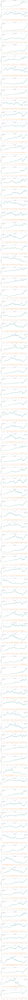

In [ ]:
#Plot of daily stock price and time-series characteristics
fig, axes = plt.subplots(nrows=len(df.columns), ncols=1,figsize=(15,500))
for i in range(len(df.columns)):
    axes[i].plot(df[df.columns[i]], label='Observed Stock Price')
    cycle, trend = sm.tsa.filters.hpfilter(df[df.columns[i]]) #returns cycle and trend
    axes[i].plot(cycle, label="cycle")
    axes[i].plot(trend, label="trend")
    axes[i].set_xlabel('time')
    axes[i].set_ylabel('stock close price')
    axes[i].set_title(df.columns[i])
    axes[i].legend()
fig.tight_layout(pad=3.0)

In [ ]:
df_seasonal = df.copy()

In [ ]:
df_seasonal['month'] = df_seasonal.index.month

C:\Users\santosh2\AppData\Local\Temp/ipykernel_9076/3764630319.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(18,5))


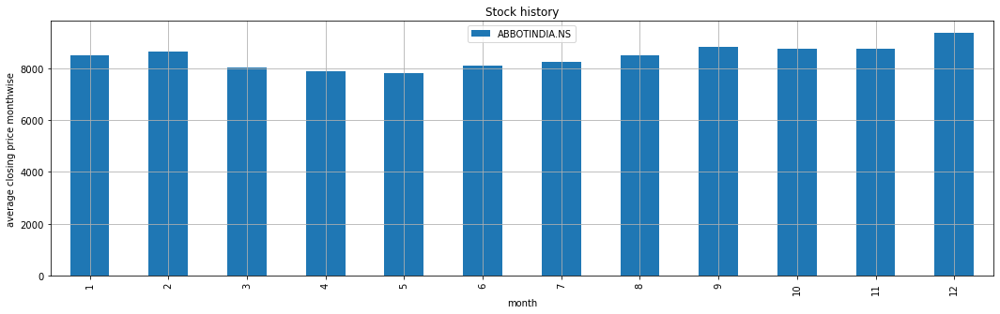

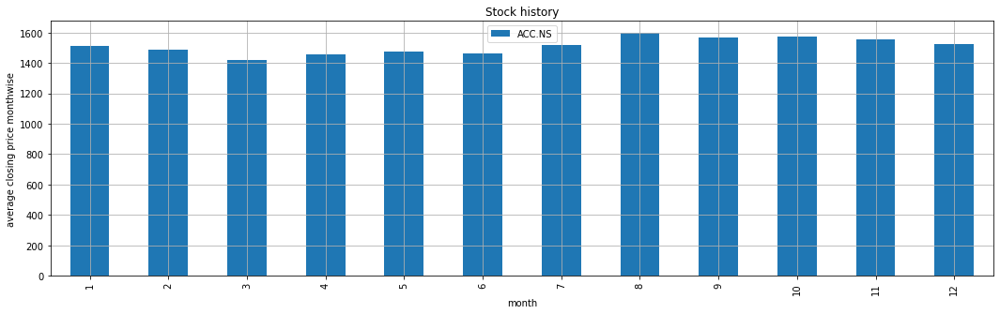

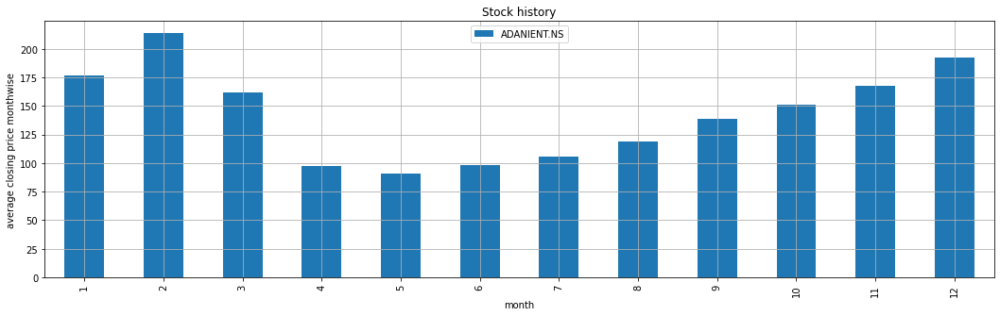

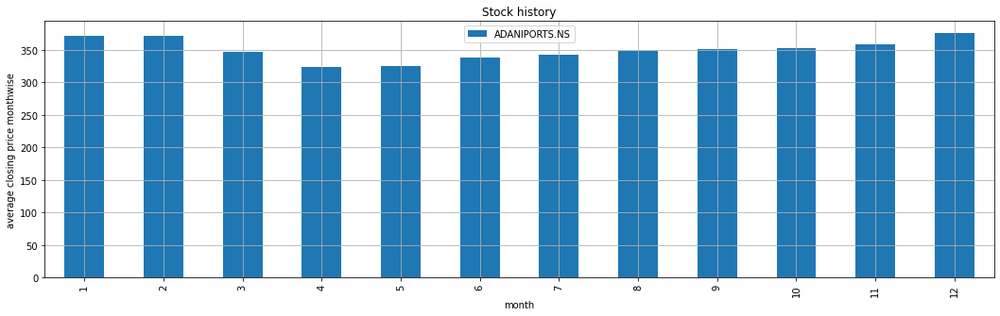

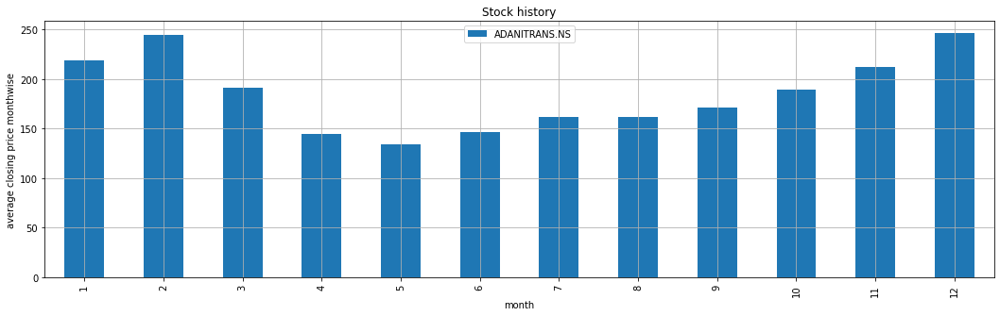

...

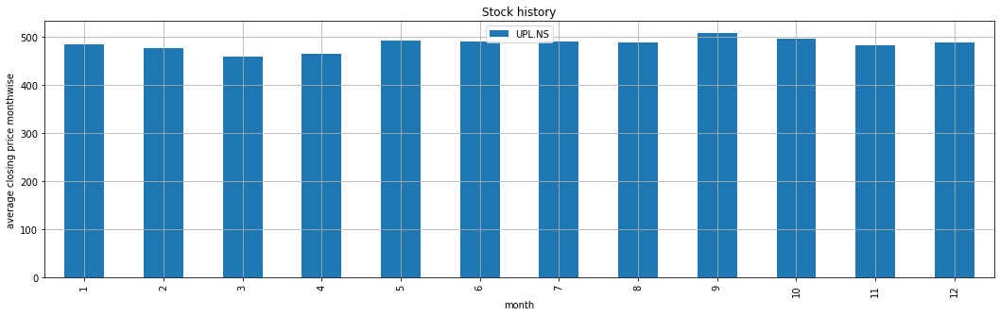

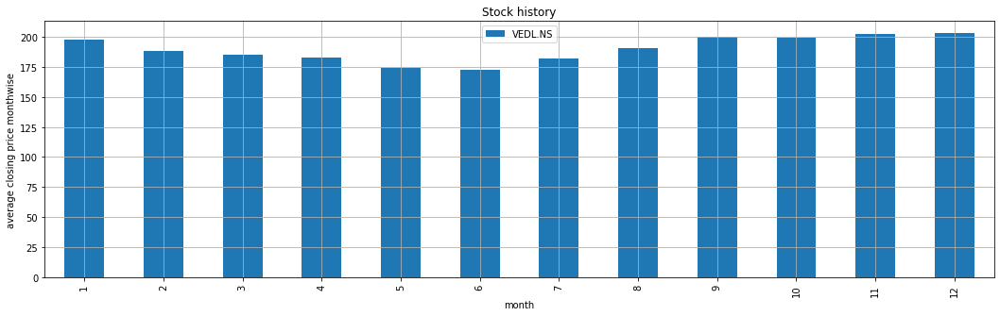

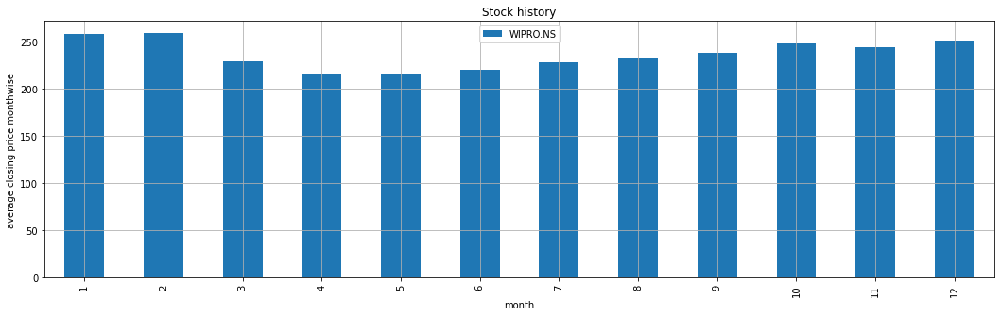

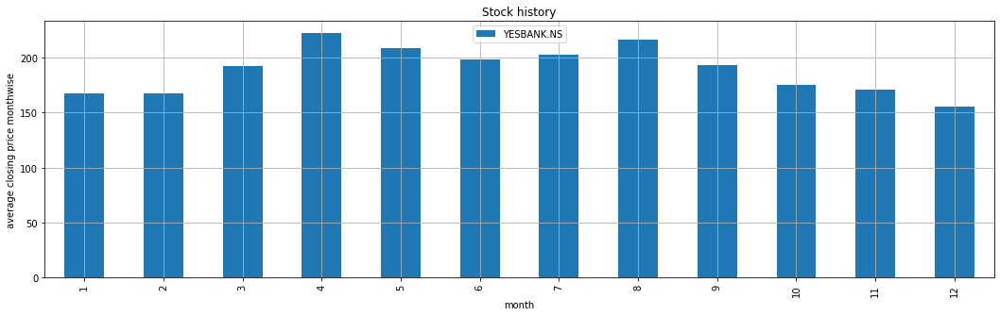

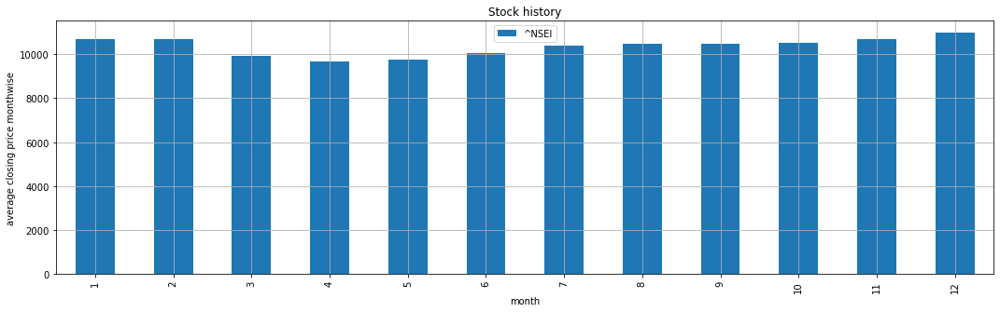

In [ ]:
#Monthwise seasonality
for i in df_seasonal.columns.difference(['month']):
    plt.figure(figsize=(18,5))
    df_seasonal.groupby(['month'])[i].mean().plot.bar()
    plt.xlabel('month')
    plt.ylabel("average closing price monthwise")
    plt.title("Stock history")
    plt.legend(loc='upper center')
    plt.grid(True)

In [ ]:
#Total Return
total_return = df.pct_change(1)
total_return.dropna(axis=0, inplace=True)

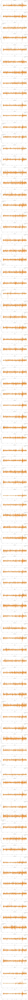

In [ ]:
#Plotting total return
fig, axes = plt.subplots(nrows=len(total_return.columns), ncols=1,figsize=(15,500))
for i in range(len(total_return.columns)):
    axes[i].plot(total_return[total_return.columns[i]], label='Observed total return')
    cycle, trend = sm.tsa.filters.hpfilter(total_return[total_return.columns[i]]) #returns cycle and trend
    axes[i].plot(cycle, label="cycle")
    axes[i].plot(trend, label="trend")
    axes[i].set_xlabel('time')
    axes[i].set_ylabel('stock total return')
    axes[i].set_title(total_return.columns[i])
    axes[i].legend()
fig.tight_layout(pad=3.0)

In [ ]:
total_return_seasonal = total_return.copy()

In [ ]:
total_return_seasonal['month'] = total_return_seasonal.index.month

C:\Users\santosh2\AppData\Local\Temp/ipykernel_9076/4219950613.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(18,5))


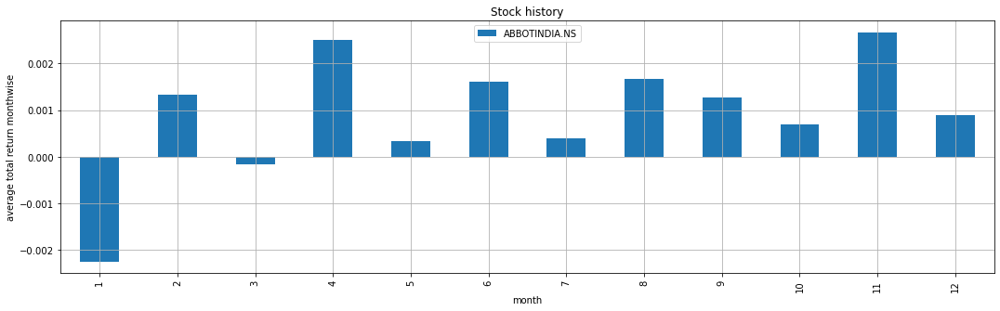

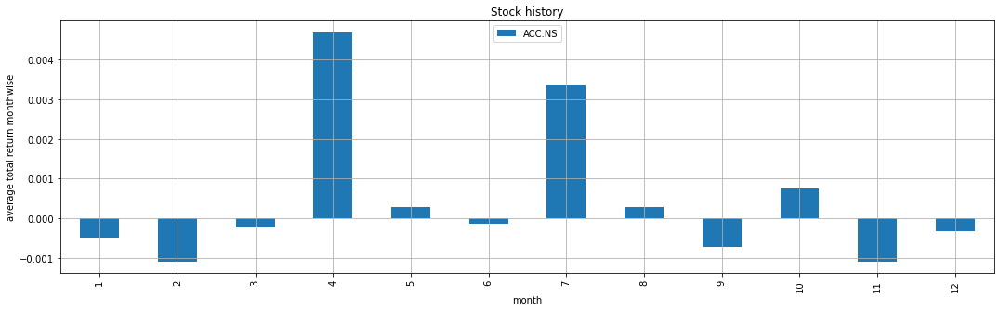

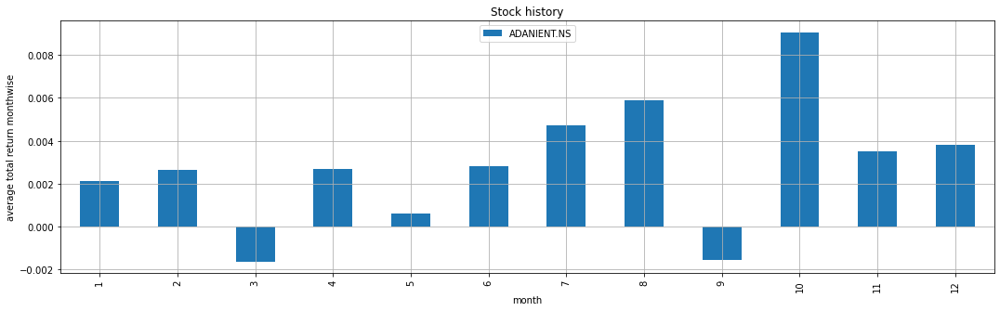

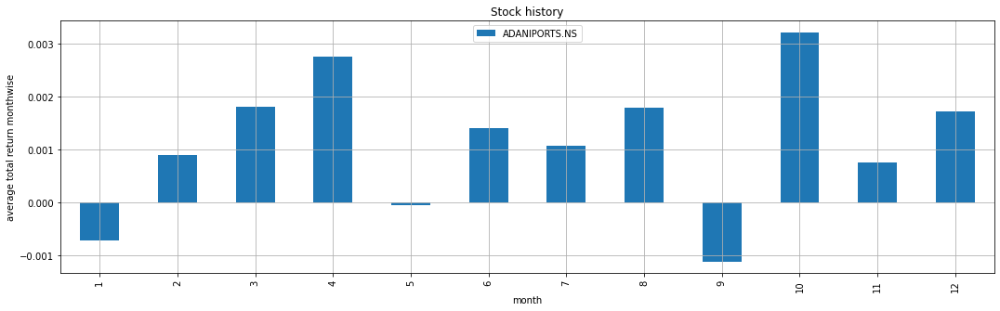

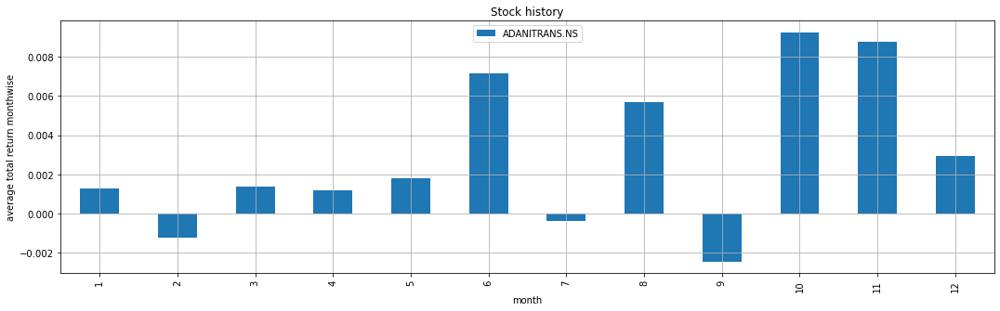

...

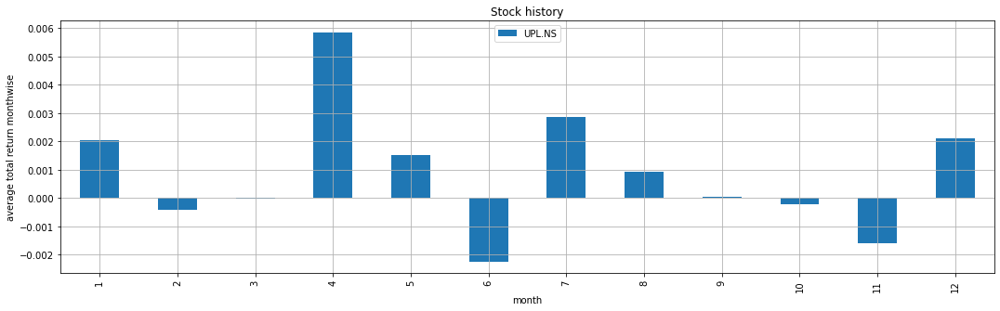

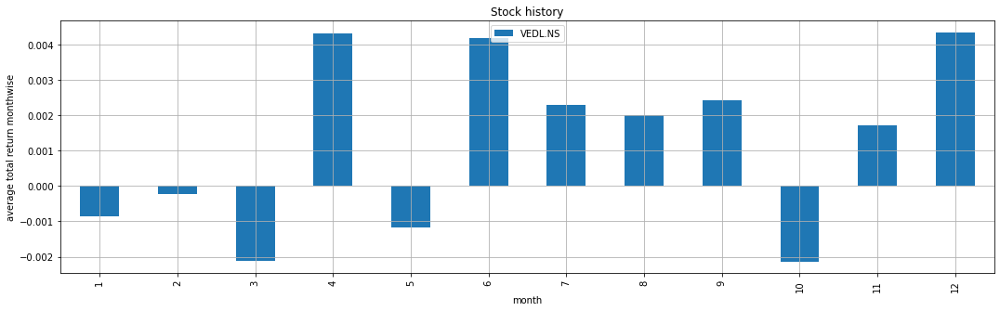

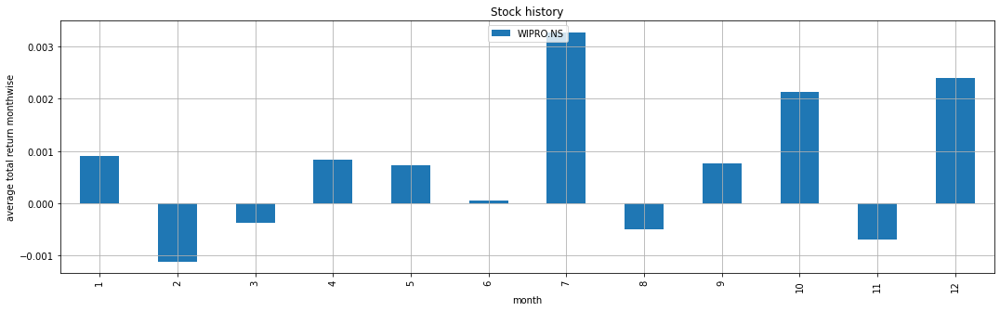

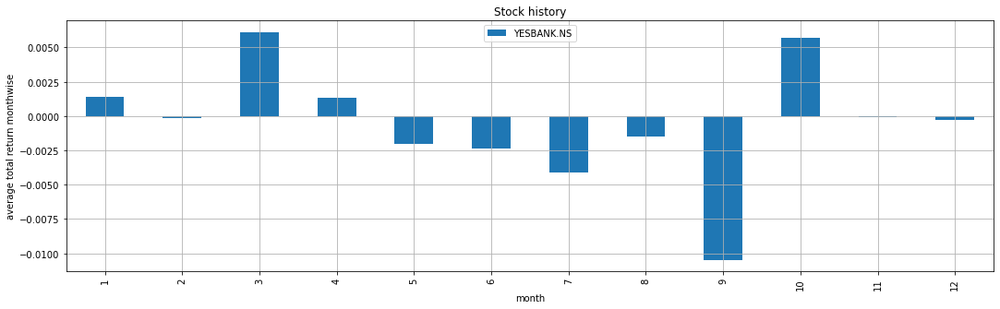

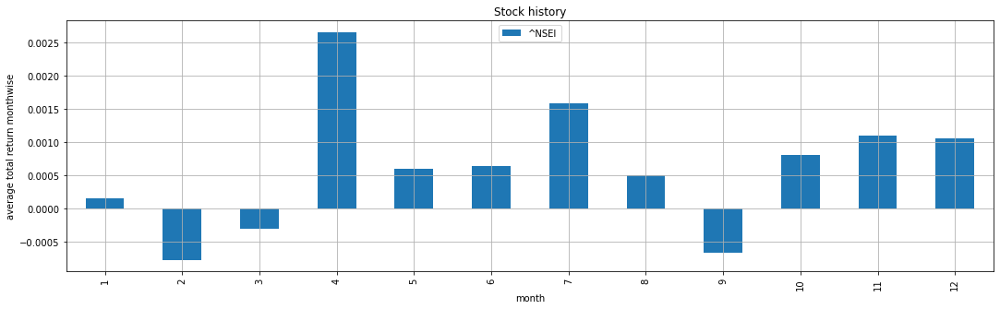

In [ ]:
#Monthwise seasonality of total return
for i in total_return_seasonal.columns.difference(['month']):
    plt.figure(figsize=(18,5))
    total_return_seasonal.groupby(['month'])[i].mean().plot.bar()
    plt.xlabel('month')
    plt.ylabel("average total return monthwise")
    plt.title("Stock history")
    plt.legend(loc='upper center')
    plt.grid(True)

In [ ]:
#Log total return
log_return = np.log(df/df.shift(1))
log_return.dropna(axis=0, inplace=True)

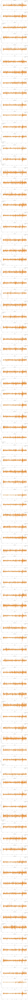

In [ ]:
#Plotting log return
fig, axes = plt.subplots(nrows=len(log_return.columns), ncols=1,figsize=(15,500))
for i in range(len(log_return.columns)):
    axes[i].plot(log_return[log_return.columns[i]], label='Observed log return')
    cycle, trend = sm.tsa.filters.hpfilter(log_return[log_return.columns[i]]) #returns cycle and trend
    axes[i].plot(cycle, label="cycle")
    axes[i].plot(trend, label="trend")
    axes[i].set_xlabel('time')
    axes[i].set_ylabel('stock log return')
    axes[i].set_title(log_return.columns[i])
    axes[i].legend()
fig.tight_layout(pad=3.0)

In [ ]:
log_return_seasonal = log_return.copy()

In [ ]:
log_return_seasonal['month'] = log_return_seasonal.index.month

<ipython-input-29-7b1b2b3034d0>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(18,5))


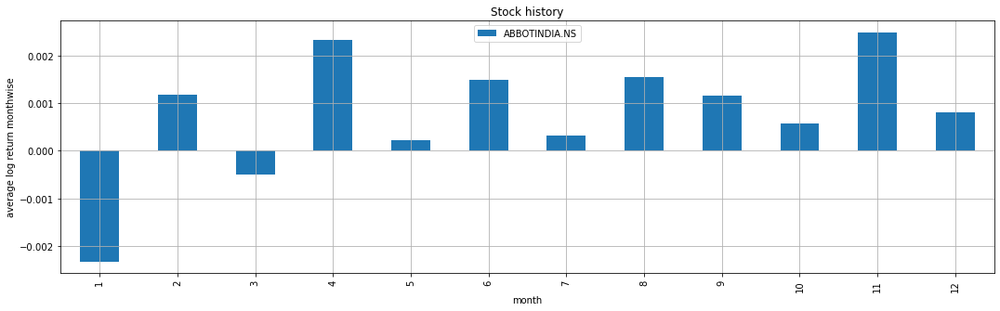

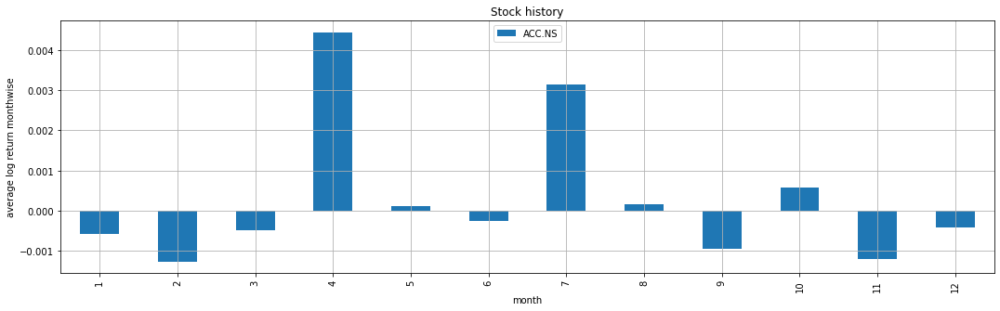

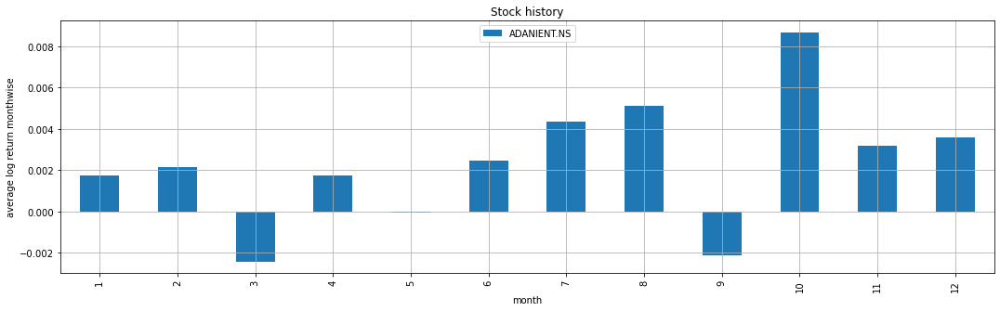

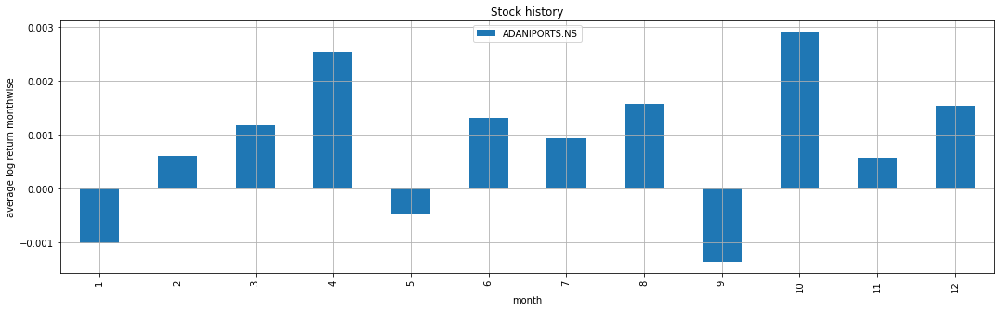

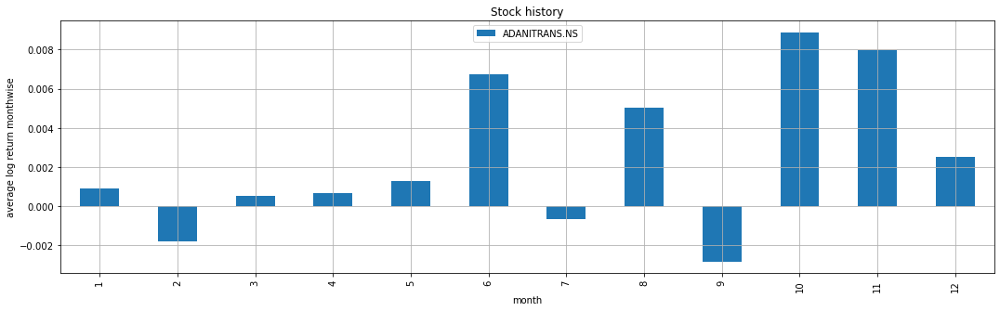

...

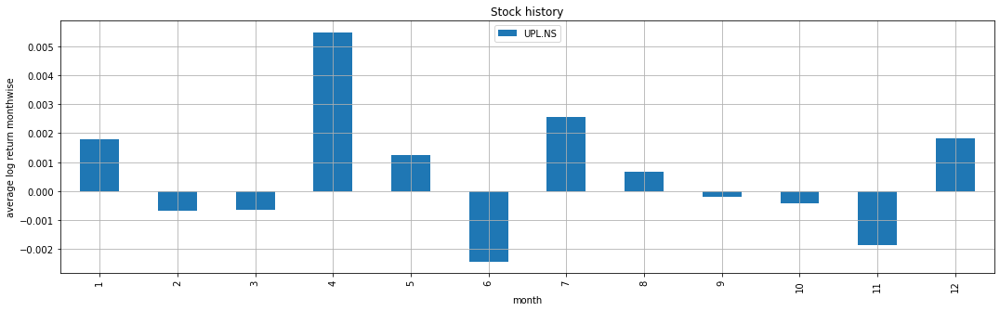

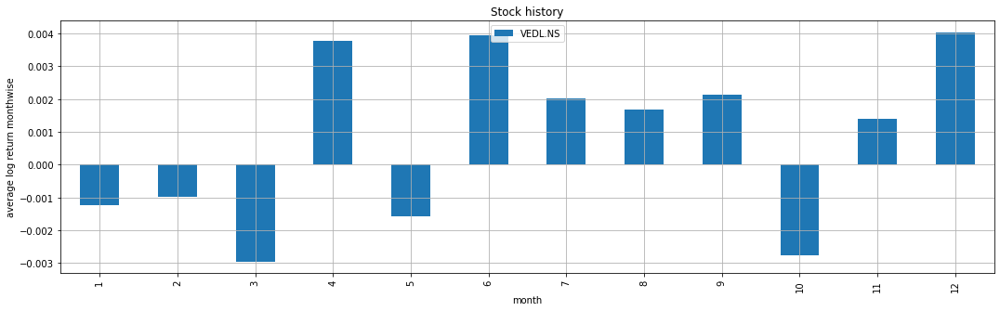

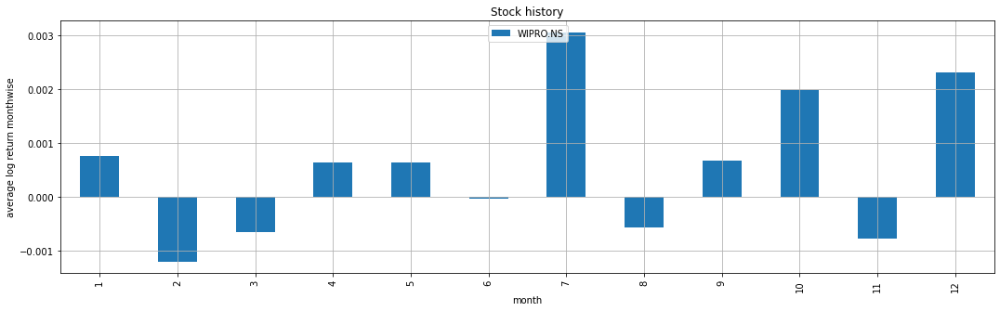

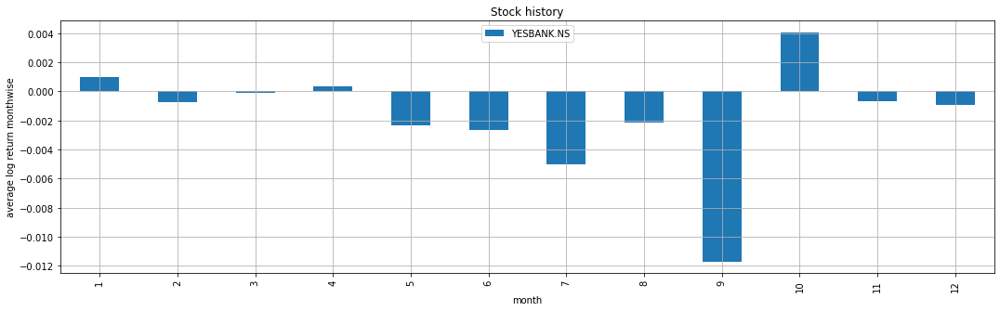

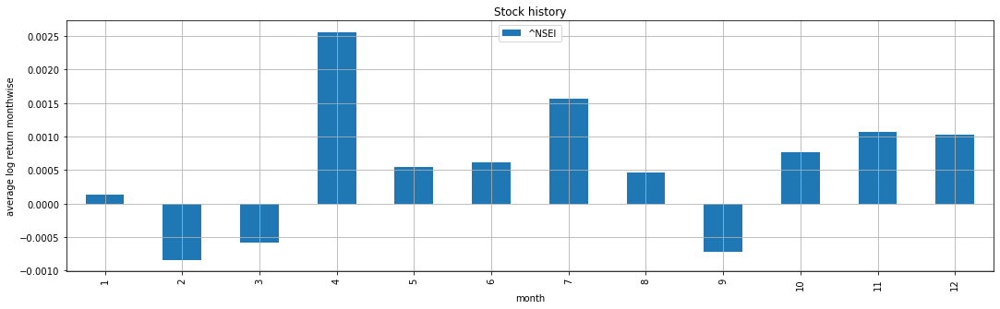

In [ ]:
#Monthwise seasonality of log return
for i in log_return_seasonal.columns.difference(['month']):
    plt.figure(figsize=(18,5))
    log_return_seasonal.groupby(['month'])[i].mean().plot.bar()
    plt.xlabel('month')
    plt.ylabel("average log return monthwise")
    plt.title("Stock history")
    plt.legend(loc='upper center')
    plt.grid(True)

### Task 2: Check the distribution of these returns. Present test statistics whether the returns are following a normal distribution. If not, then fit other distribution types which fit the data better

In [ ]:
from scipy.stats import norm

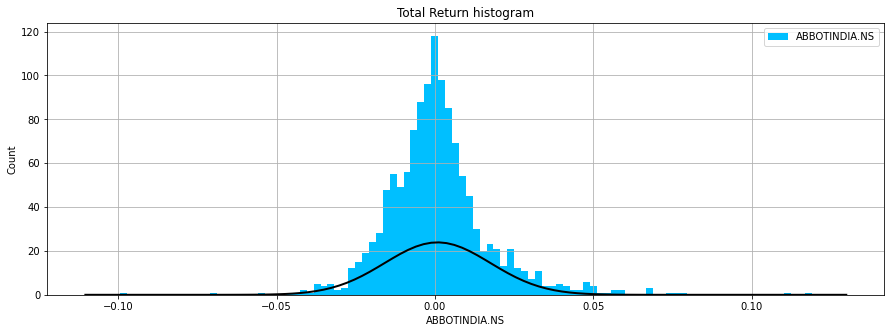

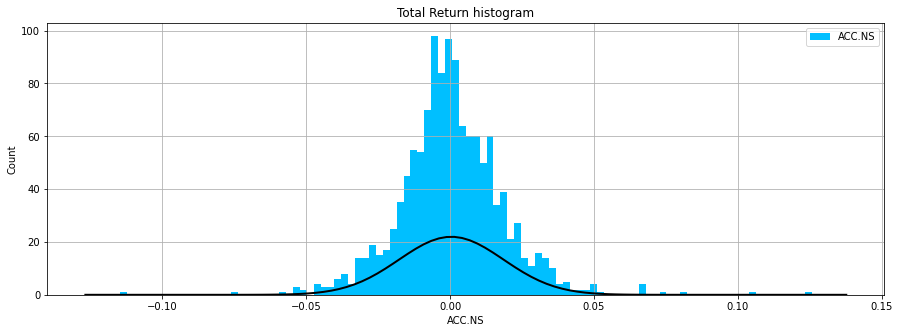

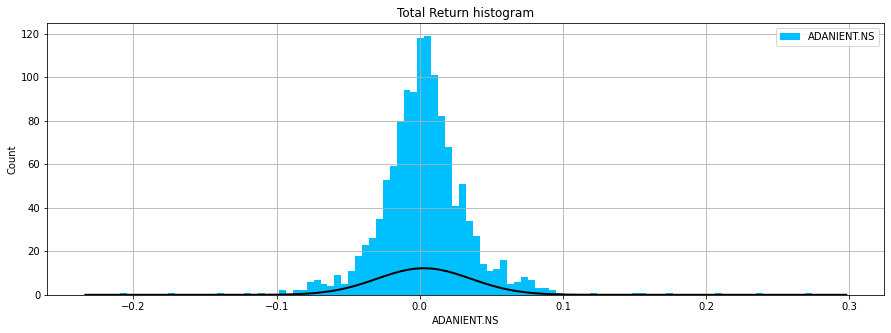

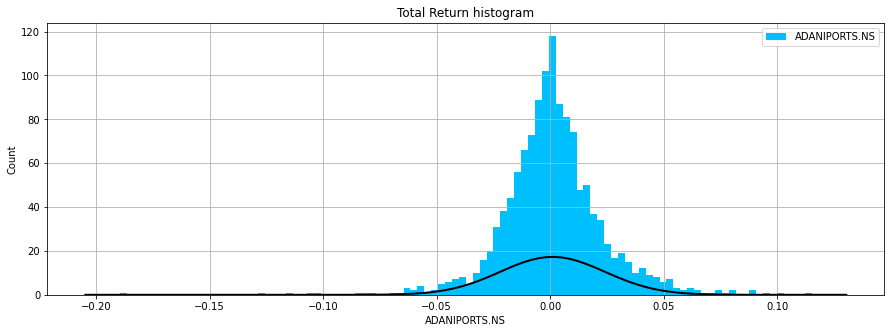

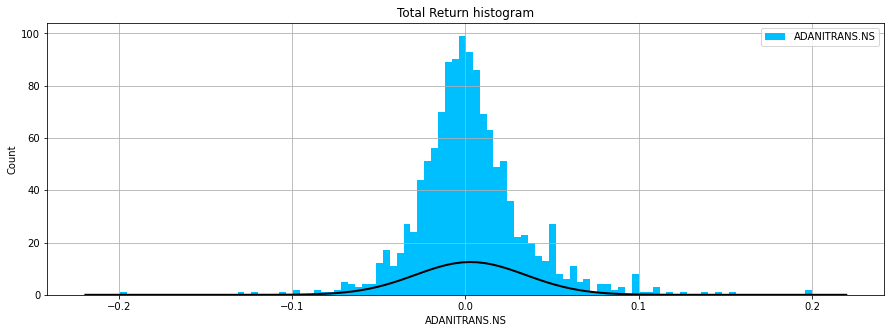

...

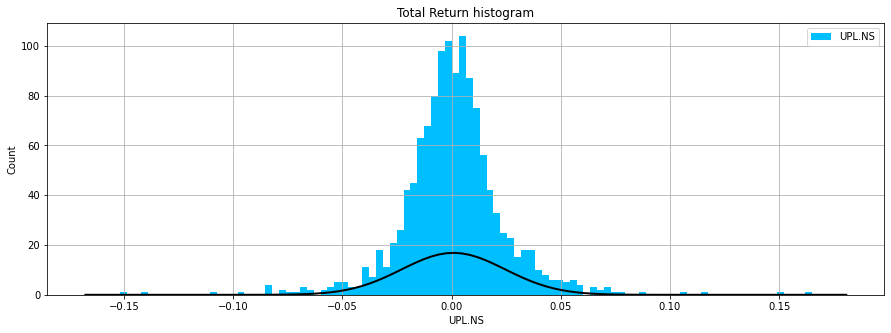

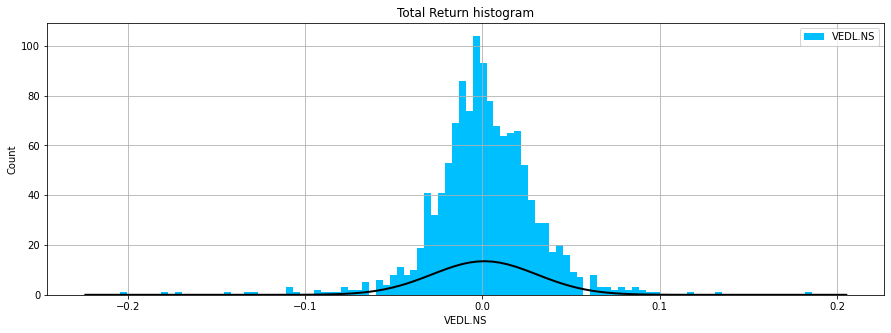

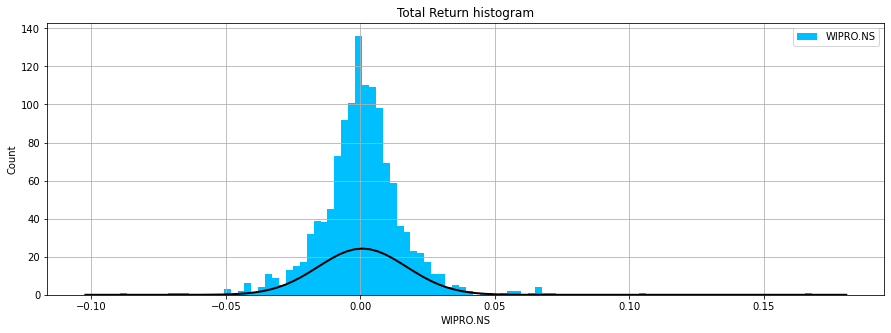

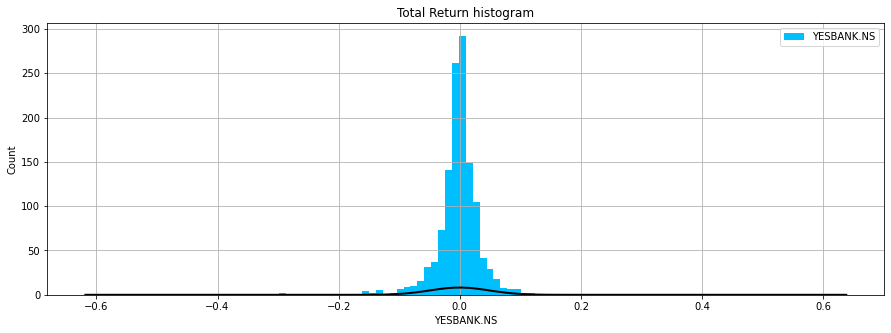

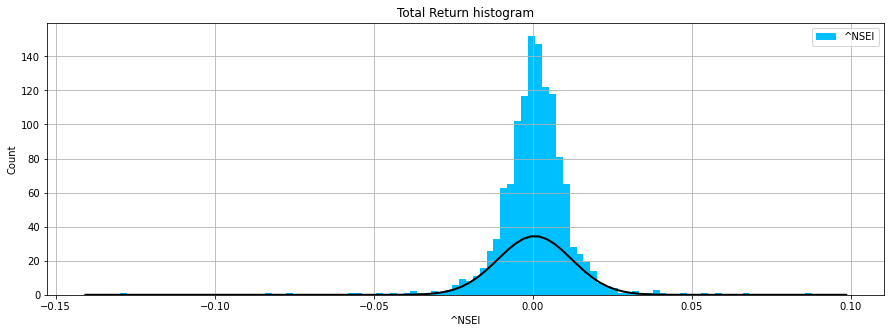

In [ ]:
for feature in total_return:
    fig= plt.figure(figsize=(15,5))
    #plotting histogram
    total_return[feature].hist(bins=100, color='deepskyblue', label= feature)
    
    plt.xlabel(feature)
    plt.ylabel("Count")
    plt.title("Total Return histogram")
    plt.legend(loc='upper right')
    
    #plotting normal distribution
    mean, std = norm.fit(total_return[feature])
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mean, std)
    plt.plot(x, p, 'k', linewidth=2, label = "Fit results: mean = %.2f,  std = %.2f" % (mean, std))
    
    plt.show()

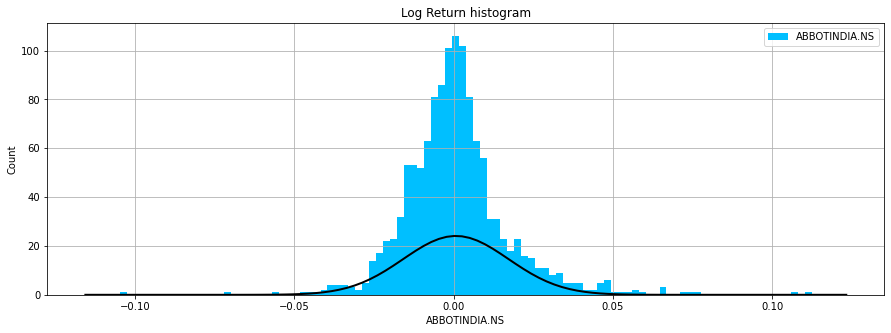

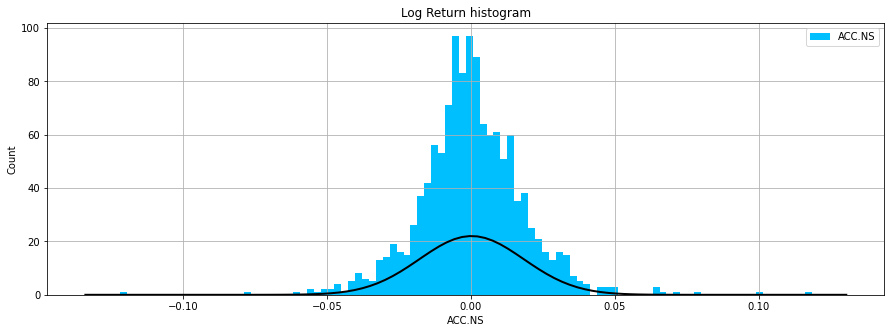

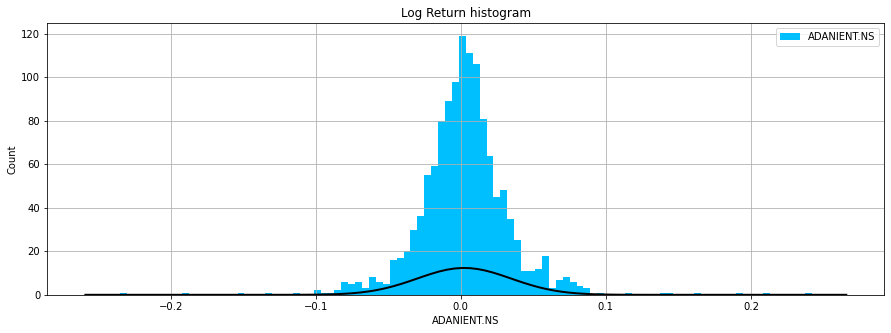

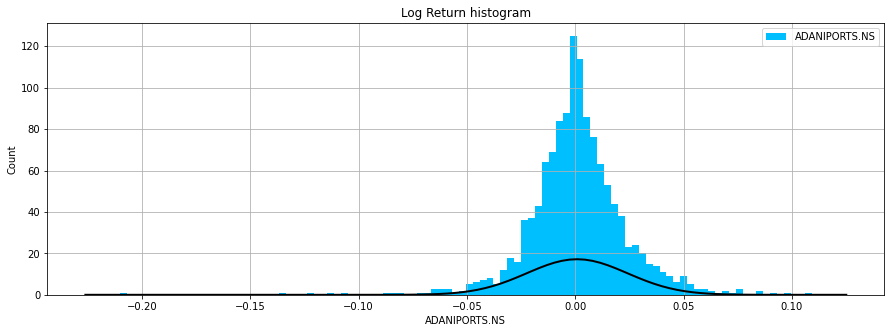

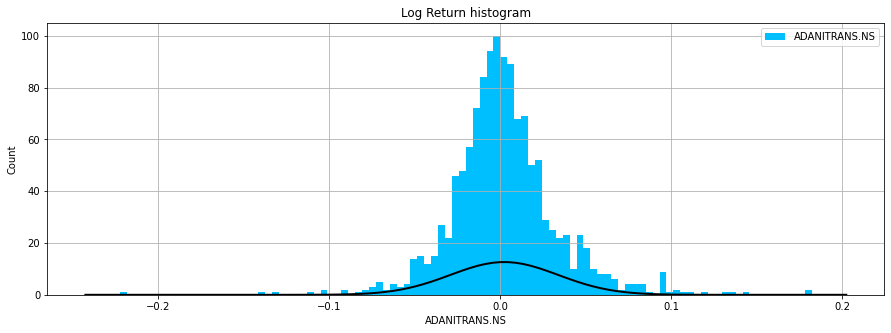

...

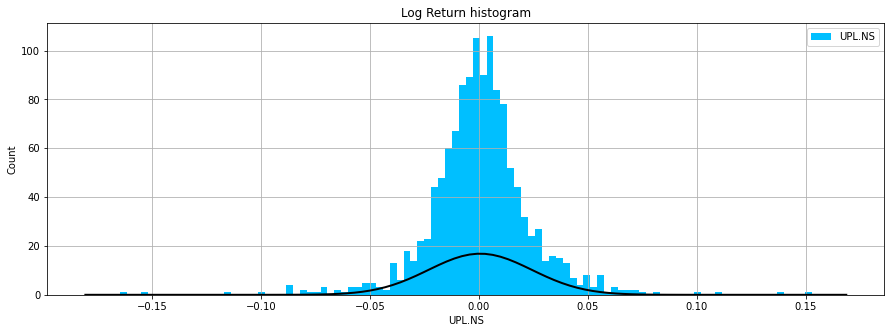

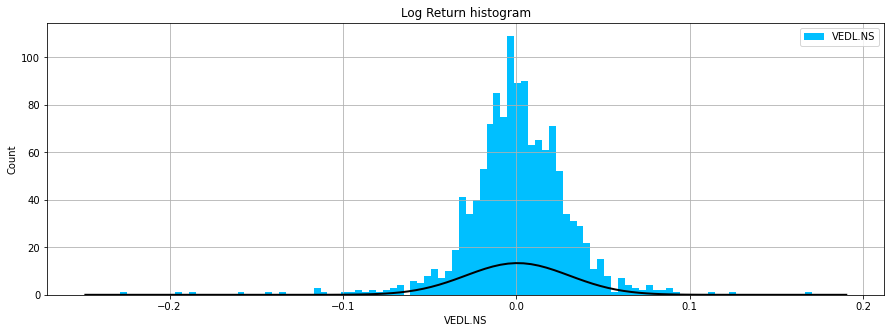

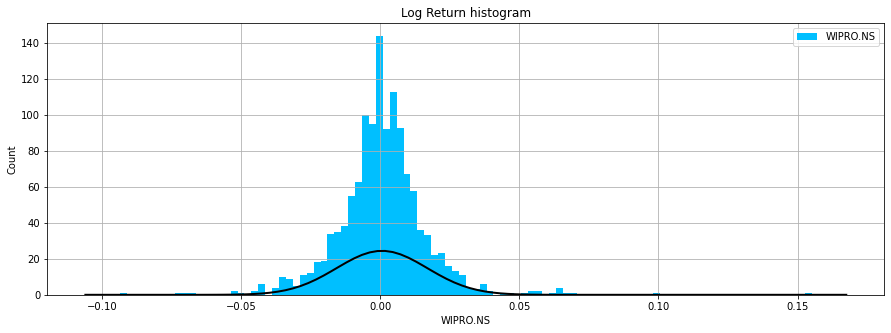

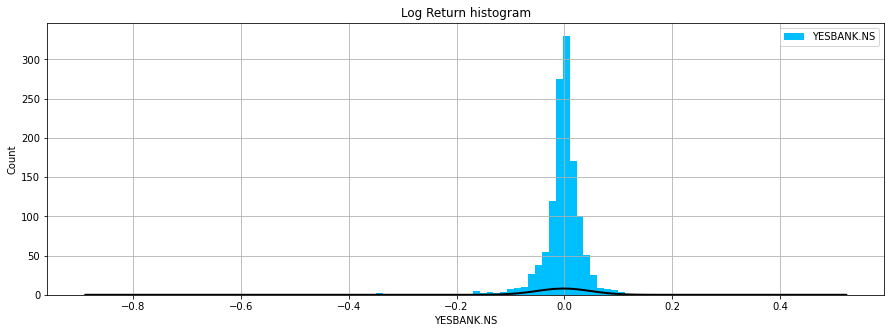

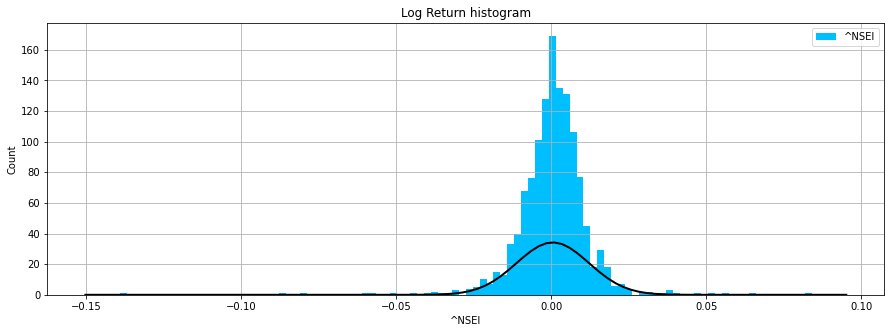

In [ ]:
for feature in log_return:
    fig= plt.figure(figsize=(15,5))
    #plotting histogram
    log_return[feature].hist(bins=100, color='deepskyblue', label= feature)
    
    plt.xlabel(feature)
    plt.ylabel("Count")
    plt.title("Log Return histogram")
    plt.legend(loc='upper right')
    
    #plotting normal distribution
    mean, std = norm.fit(log_return[feature])
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mean, std)
    plt.plot(x, p, 'k', linewidth=2, label = "Fit results: mean = %.2f,  std = %.2f" % (mean, std))
    
    plt.show()

In [ ]:
#Test statistics for normal distribution for total returns
for i in total_return.columns:
    k2, p = stats.normaltest(total_return[i])
    alpha = 0.05
    print(k2, p)
    if p < alpha: # null hypothesis: Our stocks comes from a normal distribution
        print("The null hypothesis can be rejected")
    else:
        print("The null hypothesis cannot be rejected")

338.05381977721163 3.913323421740253e-74
The null hypothesis can be rejected
165.0874638995699 1.418119074304345e-36
The null hypothesis can be rejected
339.7833152424023 1.6481266188432545e-74
The null hypothesis can be rejected
222.47827466667346 4.8916624907771235e-49
The null hypothesis can be rejected
235.02988736587832 9.202554906697597e-52
The null hypothesis can be rejected
253.6197135359389 8.45627221256962e-56
The null hypothesis can be rejected
90.69192668324574 2.0253418846988475e-20
The null hypothesis can be rejected
227.8372270917988 3.355635273624678e-50
The null hypothesis can be rejected
187.91760185704348 1.5639081053614098e-41
The null hypothesis can be rejected
283.96222309767467 2.1796497893168047e-62
The null hypothesis can be rejected
397.9679135814149 3.8226591758586395e-87
The null hypothesis can be rejected
231.4420816640152 5.533380388968746e-51
The null hypothesis can be rejected
399.4536778119349 1.8185949264856592e-87
The null hypothesis can be rejected
3

In [ ]:
#Test statistics for normal distribution for log returns
for i in log_return.columns:
    k2, p = stats.normaltest(log_return[i])
    alpha = 0.05
    print(k2, p)
    if p < alpha: # null hypothesis: Our stocks comes from a normal distribution
        print("The null hypothesis can be rejected")
    else:
        print("The null hypothesis cannot be rejected")

288.2333119798216 2.5759151491732587e-63
The null hypothesis can be rejected
142.05598508845907 1.4221151969111053e-31
The null hypothesis can be rejected
231.73671374375226 4.775424501505965e-51
The null hypothesis can be rejected
315.2451238435583 3.510679100922505e-69
The null hypothesis can be rejected
177.60403516796526 2.7150246778311025e-39
The null hypothesis can be rejected
199.5004792415642 4.775527652437342e-44
The null hypothesis can be rejected
79.81618289052082 4.6573202479027775e-18
The null hypothesis can be rejected
194.62056129807894 5.478757543989818e-43
The null hypothesis can be rejected
234.72816075352014 1.070107773112045e-51
The null hypothesis can be rejected
281.9328267642971 6.012630761574917e-62
The null hypothesis can be rejected
657.548777081624 1.6409572446770465e-143
The null hypothesis can be rejected
256.46296501835945 2.0406792099316825e-56
The null hypothesis can be rejected
614.7441530006062 3.235961044304694e-134
The null hypothesis can be rejected

In [ ]:
#For fitting distributions we have picked only 4 stocks of different volatility
dist_list = ['alpha','anglit','arcsine','beta','betaprime','bradford','burr','burr12','cauchy','chi','chi2',
             'cosine','dgamma','dweibull','erlang','expon','exponnorm','exponweib','exponpow','f','fatiguelife',
             'fisk','foldcauchy','foldnorm','genlogistic','genpareto','gennorm','genexpon','genextreme',
             'gausshyper','gamma','gengamma','genhalflogistic','gilbrat','gompertz','gumbel_r','gumbel_l',
             'halfcauchy','halflogistic','halfnorm','halfgennorm','hypsecant','invgamma','invgauss','invweibull',
             'johnsonsb','johnsonsu','kstwobign','laplace','levy','levy_l','logistic','loggamma','loglaplace',
             'lognorm','lomax','maxwell','mielke','nakagami','ncx2','ncf','nct','norm','pareto','pearson3',
             'powerlaw','powerlognorm','powernorm','rdist','reciprocal','rayleigh','rice','recipinvgauss',
             'semicircular','t','triang','truncexpon','truncnorm','tukeylambda','uniform','vonmises',
             'vonmises_line','wald','weibull_min','weibull_max']
len(dist_list)

85

In [ ]:
#Fitting total returns
results = []
stocks_fit_dist = ['TATAMOTORS.NS','SBIN.NS','SIEMENS.NS','HINDUNILVR.NS','^NSEI']
for i in stocks_fit_dist:
    print("**********************************************************************************")
    print("The distributions test for", i)
    print("**********************************************************************************")
    for j in dist_list:
        dist = getattr(stats, j)
        param = dist.fit(total_return[i])
        a = stats.kstest(total_return[i], j, args=param)
        results.append((j,a[0],a[1]))    
    results.sort(key=lambda x:float(x[2]), reverse=True)
    for k in results:
        print("{}: statistic={}, pvalue={}".format(k[0], k[1], k[2]))

**********************************************************************************
The distributions test for TATAMOTORS.NS
**********************************************************************************


C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2606: RuntimeWarning: invalid value encountered in double_scalars
  Lhat = muhat - Shat*mu
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:639: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:801: RuntimeWarning: divide by zero encountered in true_divide
  a/(b-1.0),
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:805: RuntimeWarning: divide by zero encountered in true_divide
  a*(a+1.0)/((b-2.0)*(b-1.0)),
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_co

johnsonsu: statistic=0.01428523823942529, pvalue=0.9537918484420916
nct: statistic=0.01769497308091955, pvalue=0.8126996071546447
t: statistic=0.018623668141255656, pvalue=0.761068297289756
laplace: statistic=0.020181198773496778, pvalue=0.6689454284782068
loglaplace: statistic=0.020198749193442778, pvalue=0.6678891954054889
gennorm: statistic=0.022481482815750797, pvalue=0.5322004471723321
dweibull: statistic=0.02430754284202874, pvalue=0.4316758763788704
dgamma: statistic=0.025518240189807972, pvalue=0.3712592885371133
hypsecant: statistic=0.028656850204887396, pvalue=0.24127079717116362
tukeylambda: statistic=0.037336407534129534, pvalue=0.05574462071542852
logistic: statistic=0.03880287571189189, pvalue=0.041886267814669864
burr: statistic=0.03957810521542038, pvalue=0.03585269635307853
mielke: statistic=0.03957825938838122, pvalue=0.035851576394626106
genlogistic: statistic=0.03971703118620773, pvalue=0.03485583508141199
fisk: statistic=0.03993983564939879, pvalue=0.03330778918123

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.22222222222221855.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.7777777777777755.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.5740740740740713.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.5679012345678986.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape par

johnsonsu: statistic=0.01259300156698917, pvalue=0.9860423141072306
johnsonsu: statistic=0.01428523823942529, pvalue=0.9537918484420916
nct: statistic=0.01500932965162749, pvalue=0.9320229141018543
t: statistic=0.015512254498664335, pvalue=0.9140524833800687
nct: statistic=0.01769497308091955, pvalue=0.8126996071546447
t: statistic=0.018623668141255656, pvalue=0.761068297289756
hypsecant: statistic=0.020079639556499163, pvalue=0.6750545936477689
laplace: statistic=0.020181198773496778, pvalue=0.6689454284782068
loglaplace: statistic=0.020198749193442778, pvalue=0.6678891954054889
tukeylambda: statistic=0.021584991117075014, pvalue=0.5847119722688143
gennorm: statistic=0.022246900366076128, pvalue=0.5457839226398047
gennorm: statistic=0.022481482815750797, pvalue=0.5322004471723321
loglaplace: statistic=0.024238970280767158, pvalue=0.4352580604289096
dweibull: statistic=0.02430754284202874, pvalue=0.4316758763788704
laplace: statistic=0.025354203929596086, pvalue=0.37912188258488433
dga

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 94.5.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 85.5.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 87.75.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 88.5.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-i

johnsonsu: statistic=0.01259300156698917, pvalue=0.9860423141072306
johnsonsu: statistic=0.01428523823942529, pvalue=0.9537918484420916
johnsonsu: statistic=0.014438873309252531, pvalue=0.949584168446714
nct: statistic=0.01500932965162749, pvalue=0.9320229141018543
t: statistic=0.015512254498664335, pvalue=0.9140524833800687
nct: statistic=0.01556807897174306, pvalue=0.9119183137268368
hypsecant: statistic=0.015808407819124293, pvalue=0.9024222856298189
gennorm: statistic=0.018195725112582772, pvalue=0.7853038519843655
loglaplace: statistic=0.02459894616272637, pvalue=0.4166394112595646
recipinvgauss: statistic=nan, pvalue=nan
t: statistic=0.016575054087927588, pvalue=0.8689712553850848
nct: statistic=0.01769497308091955, pvalue=0.8126996071546447
t: statistic=0.018623668141255656, pvalue=0.761068297289756
dweibull: statistic=0.018957757574689288, pvalue=0.7417272954601666
hypsecant: statistic=0.020079639556499163, pvalue=0.6750545936477689
laplace: statistic=0.020181198773496778, pval

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.4074074074074041.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.2345679012345645.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.6086419753086392.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.6946502057613144.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape para

nct: statistic=0.011373797278837472, pvalue=0.995939263809214
johnsonsu: statistic=0.01259300156698917, pvalue=0.9860423141072306
johnsonsu: statistic=0.01428523823942529, pvalue=0.9537918484420916
johnsonsu: statistic=0.014438873309252531, pvalue=0.949584168446714
nct: statistic=0.01500932965162749, pvalue=0.9320229141018543
t: statistic=0.015512254498664335, pvalue=0.9140524833800687
nct: statistic=0.01556807897174306, pvalue=0.9119183137268368
hypsecant: statistic=0.015808407819124293, pvalue=0.9024222856298189
gennorm: statistic=0.018195725112582772, pvalue=0.7853038519843655
loglaplace: statistic=0.02459894616272637, pvalue=0.4166394112595646
recipinvgauss: statistic=nan, pvalue=nan
johnsonsu: statistic=0.012405693759622194, pvalue=0.988168735883823
t: statistic=0.015514603040540753, pvalue=0.9139632496783142
t: statistic=0.016575054087927588, pvalue=0.8689712553850848
nct: statistic=0.01769497308091955, pvalue=0.8126996071546447
tukeylambda: statistic=0.01784252516431928, pvalue=

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.49382716049382425.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.37860082304526466.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.6446502057613142.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.7186556927297643.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape pa

nct: statistic=0.011063948361824227, pvalue=0.9972327426744481
nct: statistic=0.011373797278837472, pvalue=0.995939263809214
johnsonsu: statistic=0.01259300156698917, pvalue=0.9860423141072306
johnsonsu: statistic=0.012866228667370305, pvalue=0.9824741455856006
johnsonsu: statistic=0.01428523823942529, pvalue=0.9537918484420916
johnsonsu: statistic=0.014438873309252531, pvalue=0.949584168446714
nct: statistic=0.01500932965162749, pvalue=0.9320229141018543
t: statistic=0.015512254498664335, pvalue=0.9140524833800687
nct: statistic=0.01556807897174306, pvalue=0.9119183137268368
recipinvgauss: statistic=nan, pvalue=nan
tukeylambda: statistic=0.015765252625706383, pvalue=0.9041638809359994
hypsecant: statistic=0.015808407819124293, pvalue=0.9024222856298189
t: statistic=0.015994441898705608, pvalue=0.8947360333248217
gennorm: statistic=0.018195725112582772, pvalue=0.7853038519843655
loglaplace: statistic=0.02459894616272637, pvalue=0.4166394112595646
recipinvgauss: statistic=nan, pvalue=na

In [ ]:
#Fitting log total returns
results = []
stocks_fit_dist = ['TATAMOTORS.NS','SBIN.NS','SIEMENS.NS','HINDUNILVR.NS','^NSEI']
for i in stocks_fit_dist:
    print("**********************************************************************************")
    print("The distributions test for", i)
    print("**********************************************************************************")
    for j in dist_list:
        dist = getattr(stats, j)
        param = dist.fit(log_return[i])
        a = stats.kstest(log_return[i], j, args=param)
        results.append((j,a[0],a[1]))    
    results.sort(key=lambda x:float(x[2]), reverse=True)
    for k in results:
        print("{}: statistic={}, pvalue={}".format(k[0], k[1], k[2]))

**********************************************************************************
The distributions test for TATAMOTORS.NS
**********************************************************************************


C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 8.4.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 7.6.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 7.199999999999999.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 7.466666666666667.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution

tukeylambda: statistic=0.013161190439440196, pvalue=0.977959618267108
johnsonsu: statistic=0.013876172149878407, pvalue=0.963917730021452
nct: statistic=0.017554920855783918, pvalue=0.8201437089048312
t: statistic=0.018045534106629846, pvalue=0.7936399277719212
dweibull: statistic=0.019725259196977984, pvalue=0.6963117059616124
loglaplace: statistic=0.020221158253142635, pvalue=0.6665403710661546
laplace: statistic=0.020259103878842222, pvalue=0.664255959099985
gennorm: statistic=0.021609645123744525, pvalue=0.5832484641826343
dgamma: statistic=0.022004418189244146, pvalue=0.5599498560892857
hypsecant: statistic=0.028477539374442973, pvalue=0.24765194300120974
genlogistic: statistic=0.03887487166954473, pvalue=0.04129091260398143
logistic: statistic=0.039108023382812496, pvalue=0.03941320685804606
mielke: statistic=0.039575500553200416, pvalue=0.035871622028151084
burr: statistic=0.0395755804428044, pvalue=0.035871041414181626
burr12: statistic=0.03982441925540858, pvalue=0.03410200138

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 6.300000000000001.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 5.699999999999999.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 5.399999999999999.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 5.6.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlan

johnsonsu: statistic=0.012987477965564875, pvalue=0.9807041549476978
tukeylambda: statistic=0.013161190439440196, pvalue=0.977959618267108
johnsonsu: statistic=0.013876172149878407, pvalue=0.963917730021452
nct: statistic=0.015327113958971017, pvalue=0.9209331832050034
t: statistic=0.015572716402489029, pvalue=0.9117397974975385
nct: statistic=0.017554920855783918, pvalue=0.8201437089048312
t: statistic=0.018045534106629846, pvalue=0.7936399277719212
hypsecant: statistic=0.019118131811017625, pvalue=0.7323356689673453
dweibull: statistic=0.019725259196977984, pvalue=0.6963117059616124
loglaplace: statistic=0.020221158253142635, pvalue=0.6665403710661546
laplace: statistic=0.020259103878842222, pvalue=0.664255959099985
dgamma: statistic=0.020435166846686836, pvalue=0.653651882565832
gennorm: statistic=0.021053587476922764, pvalue=0.6164456568304364
gennorm: statistic=0.021609645123744525, pvalue=0.5832484641826343
dgamma: statistic=0.022004418189244146, pvalue=0.5599498560892857
dweibul

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 18.666666666666664.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 17.77777777777778.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 16.66666666666667.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 15.555555555555557.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parame

johnsonsu: statistic=0.012987477965564875, pvalue=0.9807041549476978
tukeylambda: statistic=0.013161190439440196, pvalue=0.977959618267108
johnsonsu: statistic=0.013876172149878407, pvalue=0.963917730021452
johnsonsu: statistic=0.014406258164326724, pvalue=0.9504959726225866
nct: statistic=0.015327113958971017, pvalue=0.9209331832050034
hypsecant: statistic=0.015346820397911687, pvalue=0.9202153339049293
t: statistic=0.015572716402489029, pvalue=0.9117397974975385
nct: statistic=0.015809792207128193, pvalue=0.9023661557187102
recipinvgauss: statistic=nan, pvalue=nan
t: statistic=0.01610316078093088, pvalue=0.8901124780811116
nct: statistic=0.017554920855783918, pvalue=0.8201437089048312
t: statistic=0.018045534106629846, pvalue=0.7936399277719212
dweibull: statistic=0.018983573211747845, pvalue=0.7402198151567077
gennorm: statistic=0.019005599409298246, pvalue=0.7389322734067458
hypsecant: statistic=0.019118131811017625, pvalue=0.7323356689673453
dweibull: statistic=0.01972525919697798

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 4.2.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 3.8.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 3.5999999999999996.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 3.7333333333333334.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distributi

nct: statistic=0.01140738496704996, pvalue=0.9957750731078845
johnsonsu: statistic=0.012987477965564875, pvalue=0.9807041549476978
tukeylambda: statistic=0.013161190439440196, pvalue=0.977959618267108
johnsonsu: statistic=0.013876172149878407, pvalue=0.963917730021452
johnsonsu: statistic=0.014406258164326724, pvalue=0.9504959726225866
nct: statistic=0.015327113958971017, pvalue=0.9209331832050034
hypsecant: statistic=0.015346820397911687, pvalue=0.9202153339049293
t: statistic=0.015572716402489029, pvalue=0.9117397974975385
nct: statistic=0.015809792207128193, pvalue=0.9023661557187102
recipinvgauss: statistic=nan, pvalue=nan
johnsonsu: statistic=0.012504371314381979, pvalue=0.9870797940020857
t: statistic=0.014259640721261069, pvalue=0.954471343944989
t: statistic=0.01610316078093088, pvalue=0.8901124780811116
tukeylambda: statistic=0.01701437180751264, pvalue=0.8478363607002353
nct: statistic=0.017554920855783918, pvalue=0.8201437089048312
t: statistic=0.018045534106629846, pvalue=0

C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 1.05.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.95.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.8999999999999999.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribution has been given a non-integer value 0.9333333333333333.
  warnings.warn(
C:\Users\santosh2\anaconda3\lib\site-packages\scipy\stats\_continuous_distns.py:2804: RuntimeWarning: The shape parameter of the erlang distribu

nct: statistic=0.01127410361244674, pvalue=0.9963978162642448
nct: statistic=0.01140738496704996, pvalue=0.9957750731078845
johnsonsu: statistic=0.012987477965564875, pvalue=0.9807041549476978
tukeylambda: statistic=0.013161190439440196, pvalue=0.977959618267108
johnsonsu: statistic=0.013876172149878407, pvalue=0.963917730021452
johnsonsu: statistic=0.014406258164326724, pvalue=0.9504959726225866
nct: statistic=0.015327113958971017, pvalue=0.9209331832050034
hypsecant: statistic=0.015346820397911687, pvalue=0.9202153339049293
t: statistic=0.015572716402489029, pvalue=0.9117397974975385
nct: statistic=0.015809792207128193, pvalue=0.9023661557187102
recipinvgauss: statistic=nan, pvalue=nan
johnsonsu: statistic=0.012504371314381979, pvalue=0.9870797940020857
johnsonsu: statistic=0.012904710315518764, pvalue=0.9819251275944291
t: statistic=0.014259640721261069, pvalue=0.954471343944989
t: statistic=0.01610316078093088, pvalue=0.8901124780811116
recipinvgauss: statistic=nan, pvalue=nan
t: s

In [ ]:
import math
import scipy.stats as scs
def main(r):
    a, b, loc, scale = scs.johnsonsu.fit(r) # fit the data and get distribution parameters back
    #γ would be a, δ would be b; ξ would be loc, λ would be scale
    return a, b  

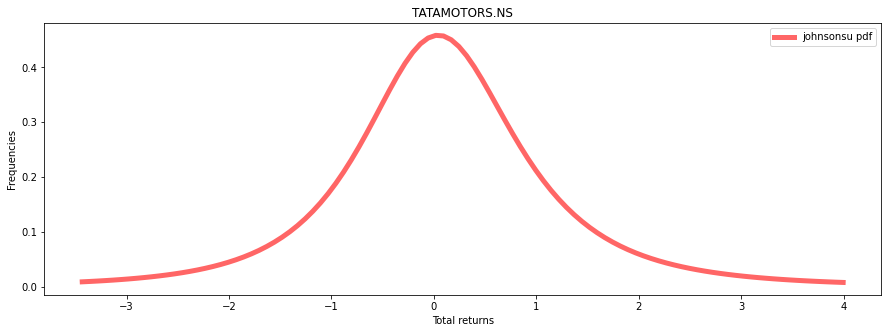

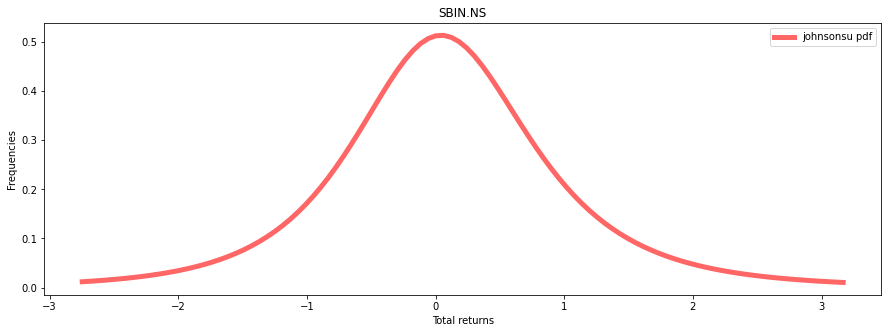

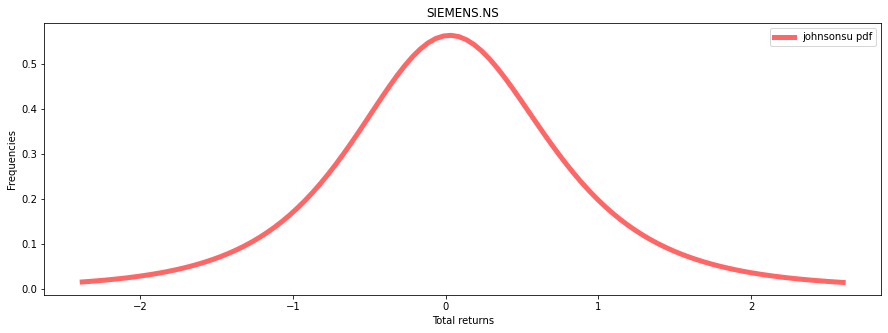

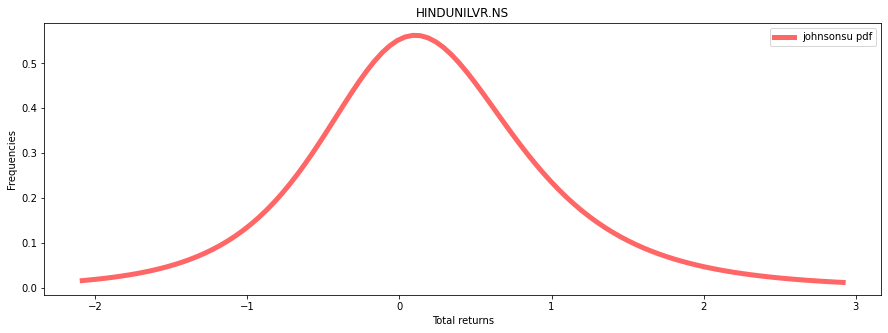

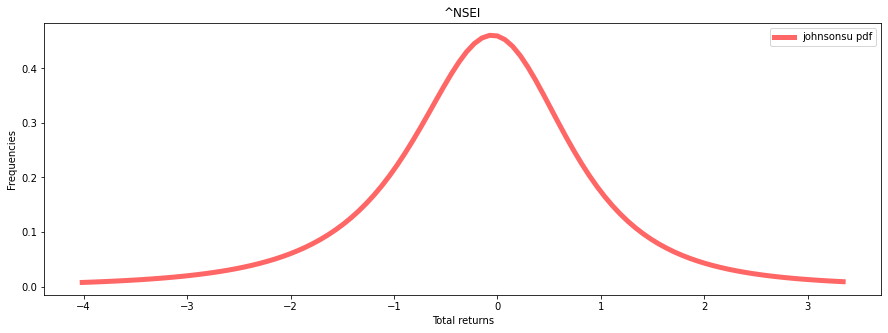

In [ ]:
#Fitting distribution to total return
from scipy.stats import johnsonsu
#Total Returns
stocks_fit_dist = ['TATAMOTORS.NS','SBIN.NS','SIEMENS.NS','HINDUNILVR.NS','^NSEI']
for i in stocks_fit_dist:
    fig= plt.figure(figsize=(15,5))

    a, b = main(total_return[i])
    x = np.linspace(johnsonsu.ppf(0.01, a, b),johnsonsu.ppf(0.99, a, b), 100)
    plt.plot(x, johnsonsu.pdf(x, a, b),'r-', lw=5, alpha=0.6, label='johnsonsu pdf')
    plt.xlabel('Total returns')
    plt.ylabel('Frequencies')
    plt.title(i)
    plt.legend(loc='upper right')
    
    #total_return[i].hist(bins=100, color='deepskyblue', label= i)
    plt.show()

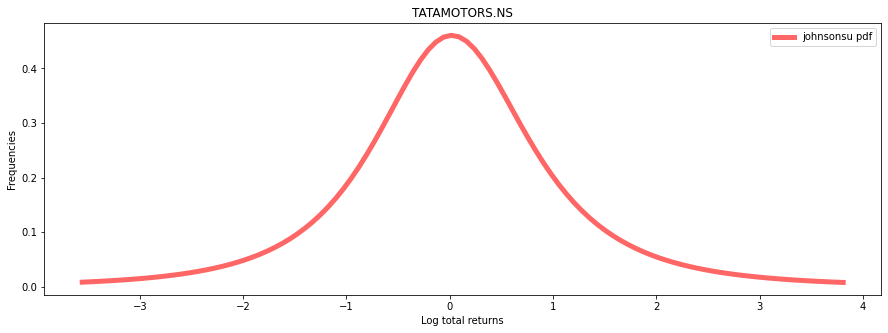

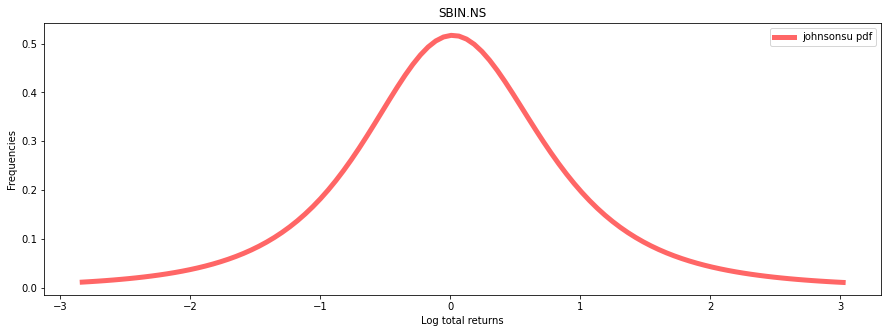

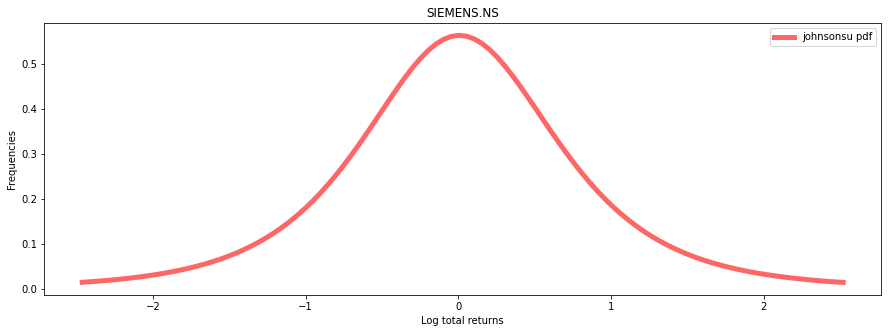

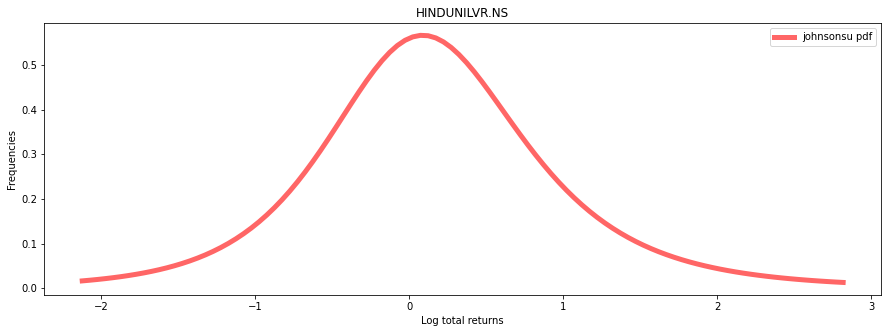

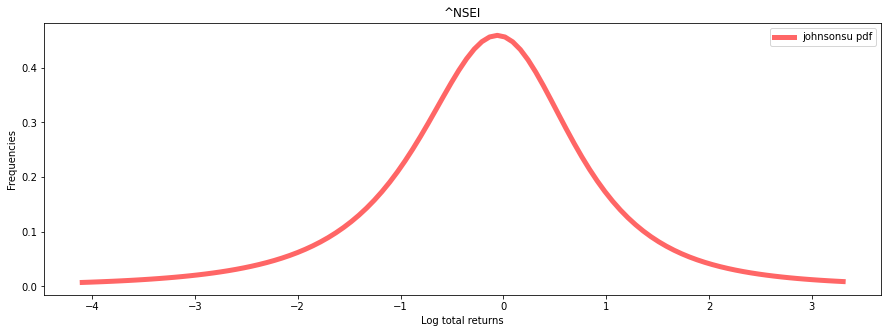

In [ ]:
#Fitting distribution to log total return
from scipy.stats import johnsonsu
#Total Returns
stocks_fit_dist = ['TATAMOTORS.NS','SBIN.NS','SIEMENS.NS','HINDUNILVR.NS','^NSEI']
for i in stocks_fit_dist:
    fig= plt.figure(figsize=(15,5))

    a, b = main(log_return[i])
    x = np.linspace(johnsonsu.ppf(0.01, a, b),johnsonsu.ppf(0.99, a, b), 100)
    plt.plot(x, johnsonsu.pdf(x, a, b),'r-', lw=5, alpha=0.6, label='johnsonsu pdf')
    plt.xlabel('Log total returns')
    plt.ylabel('Frequencies')
    plt.title(i)
    plt.legend(loc='upper right')
    
    #log_return[i].hist(bins=100, color='deepskyblue', label= feature)
    plt.show()

### Task 3: Assuming the data to be following a normal distribution, estimate the returns, variances, standard deviation, variance-covariance matrix

In [ ]:
#If the data is assumed to be normal, then the annual return is calculated in the following step
annual_total_return_norm = total_return.describe().iloc[1:3,:]
annual_total_return_norm

,ABBOTINDIA.NS,ACC.NS,ADANIENT.NS,ADANIPORTS.NS,ADANITRANS.NS,ALKEM.NS,AMBUJACEM.NS,APOLLOHOSP.NS,ASIANPAINT.NS,AUROPHARMA.NS,...,TECHM.NS,TITAN.NS,TORNTPHARM.NS,UBL.NS,ULTRACEMCO.NS,UPL.NS,VEDL.NS,WIPRO.NS,YESBANK.NS,^NSEI
mean,0.000845,0.000388,0.002849,0.001083,0.002853,0.000615,0.000462,0.000798,0.000920,0.000343,...,0.000714,0.001356,0.000600,0.000380,0.000861,0.000879,0.001158,0.000690,-0.000506,0.000583
std,0.016694,0.018166,0.032634,0.023081,0.031833,0.017289,0.018993,0.021703,0.016325,0.026084,...,0.019575,0.021377,0.019251,0.018982,0.018401,0.023680,0.029568,0.016438,0.048634,0.011571


In [ ]:
annual_total_return_norm.iloc[0,:] = (annual_total_return_norm.iloc[0,:])*252
annual_total_return_norm.iloc[1,:] = (annual_total_return_norm.iloc[1,:])*(252**0.5)
annual_total_return_norm.loc['var'] = ((annual_total_return_norm.iloc[1,:])**2)
annual_total_return_norm.loc['68% confidence_return_lower_range'] = annual_total_return_norm.loc['mean'] - 1*annual_total_return_norm.loc['std']
annual_total_return_norm.loc['68% confidence_return_upper_range'] = annual_total_return_norm.loc['mean'] + 1*annual_total_return_norm.loc['std']

annual_total_return_norm.loc['95% confidence_return_lower_range'] = annual_total_return_norm.loc['mean'] - 2*annual_total_return_norm.loc['std']
annual_total_return_norm.loc['95% confidence_return_upper_range'] = annual_total_return_norm.loc['mean'] + 2*annual_total_return_norm.loc['std']

In [ ]:
annual_total_return_norm.head(7)

,ABBOTINDIA.NS,ACC.NS,ADANIENT.NS,ADANIPORTS.NS,ADANITRANS.NS,ALKEM.NS,AMBUJACEM.NS,APOLLOHOSP.NS,ASIANPAINT.NS,AUROPHARMA.NS,...,TECHM.NS,TITAN.NS,TORNTPHARM.NS,UBL.NS,ULTRACEMCO.NS,UPL.NS,VEDL.NS,WIPRO.NS,YESBANK.NS,^NSEI
mean,0.213027,0.097790,0.717851,0.272800,0.718897,0.154937,0.116335,0.201174,0.231934,0.086521,...,0.179948,0.341640,0.151205,0.095862,0.216940,0.221482,0.291875,0.173953,-0.127465,0.146945
std,0.265004,0.288383,0.518047,0.366397,0.505339,0.274448,0.301510,0.344517,0.259148,0.414066,...,0.310736,0.339344,0.305595,0.301327,0.292114,0.375907,0.469380,0.260939,0.772033,0.183680
var,0.070227,0.083165,0.268373,0.134246,0.255368,0.075322,0.090908,0.118692,0.067158,0.171450,...,0.096557,0.115154,0.093388,0.090798,0.085331,0.141306,0.220318,0.068089,0.596035,0.033738
68% confidence_return_lower_range,-0.051977,-0.190593,0.199803,-0.093597,0.213558,-0.119511,-0.185174,-0.143344,-0.027215,-0.327545,...,-0.130787,0.002297,-0.154390,-0.205465,-0.075174,-0.154425,-0.177505,-0.086986,-0.899498,-0.036735
68% confidence_return_upper_range,0.478031,0.386173,1.235898,0.639197,1.224237,0.429386,0.417845,0.545691,0.491082,0.500586,...,0.490684,0.680984,0.456800,0.397189,0.509054,0.597388,0.761255,0.434892,0.644568,0.330625
95% confidence_return_lower_range,-0.316981,-0.478976,-0.318244,-0.459993,-0.291781,-0.393960,-0.486684,-0.487861,-0.286363,-0.741611,...,-0.441523,-0.337047,-0.459985,-0.506793,-0.367288,-0.530331,-0.646885,-0.347924,-1.671531,-0.220415
95% confidence_return_upper_range,0.743035,0.674557,1.753946,1.005593,1.729576,0.703834,0.719355,0.890208,0.750231,0.914652,...,0.801420,1.020327,0.762395,0.698517,0.801167,0.973295,1.230636,0.695831,1.416601,0.514305


In [ ]:
#Variance-Covariance matrix
total_return.cov()

,ABBOTINDIA.NS,ACC.NS,ADANIENT.NS,ADANIPORTS.NS,ADANITRANS.NS,ALKEM.NS,AMBUJACEM.NS,APOLLOHOSP.NS,ASIANPAINT.NS,AUROPHARMA.NS,...,TECHM.NS,TITAN.NS,TORNTPHARM.NS,UBL.NS,ULTRACEMCO.NS,UPL.NS,VEDL.NS,WIPRO.NS,YESBANK.NS,^NSEI
ABBOTINDIA.NS,0.000279,0.000049,0.000092,0.000060,0.000072,0.000049,0.000063,0.000073,0.000053,0.000102,...,0.000067,0.000065,0.000069,0.000049,0.000068,0.000062,0.000103,0.000033,-0.000006,0.000061
ACC.NS,0.000049,0.000330,0.000207,0.000152,0.000168,0.000028,0.000277,0.000112,0.000117,0.000138,...,0.000073,0.000123,0.000062,0.000086,0.000217,0.000136,0.000196,0.000059,0.000116,0.000121
ADANIENT.NS,0.000092,0.000207,0.001065,0.000332,0.000400,0.000050,0.000215,0.000166,0.000139,0.000240,...,0.000140,0.000176,0.000133,0.000159,0.000227,0.000227,0.000334,0.000104,0.000243,0.000186
ADANIPORTS.NS,0.000060,0.000152,0.000332,0.000533,0.000243,0.000035,0.000158,0.000120,0.000115,0.000179,...,0.000128,0.000134,0.000086,0.000122,0.000181,0.000181,0.000269,0.000074,0.000160,0.000149
ADANITRANS.NS,0.000072,0.000168,0.000400,0.000243,0.001013,0.000064,0.000169,0.000116,0.000087,0.000169,...,0.000103,0.000124,0.000091,0.000095,0.000156,0.000162,0.000277,0.000071,0.000148,0.000130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
UPL.NS,0.000062,0.000136,0.000227,0.000181,0.000162,0.000041,0.000129,0.000124,0.000125,0.000166,...,0.000138,0.000151,0.000074,0.000122,0.000159,0.000561,0.000242,0.000086,0.000087,0.000143
VEDL.NS,0.000103,0.000196,0.000334,0.000269,0.000277,0.000080,0.000203,0.000155,0.000121,0.000230,...,0.000125,0.000185,0.000119,0.000144,0.000219,0.000242,0.000874,0.000101,0.000163,0.000191
WIPRO.NS,0.000033,0.000059,0.000104,0.000074,0.000071,0.000017,0.000063,0.000070,0.000048,0.000097,...,0.000141,0.000066,0.000048,0.000041,0.000078,0.000086,0.000101,0.000270,-0.000035,0.000079
YESBANK.NS,-0.000006,0.000116,0.000243,0.000160,0.000148,-0.000032,0.000089,0.000078,0.000039,0.000120,...,0.000007,0.000085,0.000085,0.000065,0.000079,0.000087,0.000163,-0.000035,0.002365,0.000064


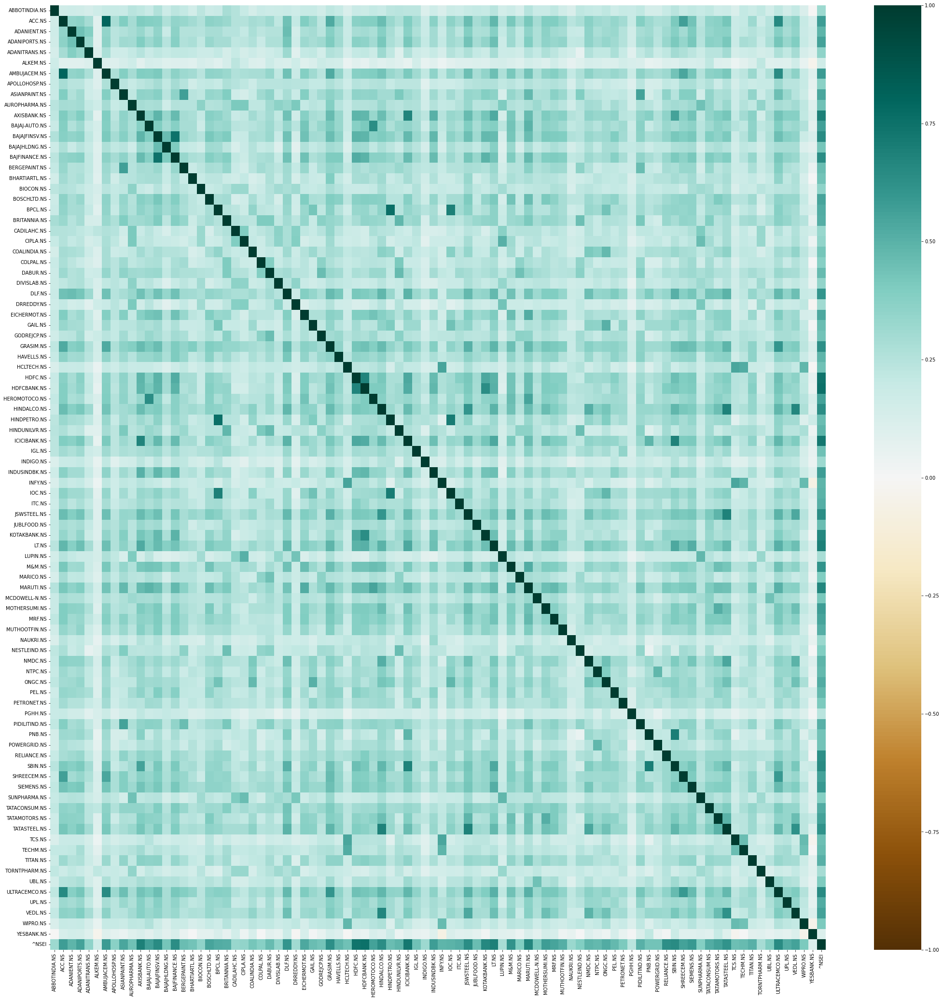

In [ ]:
#Correlation between pair of stocks total return
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
plt.figure(figsize = (36,36))
sns.heatmap(total_return.corr(), vmin=-1, vmax=1,center=0, cmap = "BrBG")
plt.show()

### Task 4: Construct a Markowitz portfolio and plot the efficient frontier. Prove that the portfolio frontier will have a parabolic structure.

Select stocts for portfolio

In [ ]:
sharpe_ratio = ((log_return.mean()/log_return.std()))*(252**0.5)

In [ ]:
sharpe_ratio = pd.DataFrame(sharpe_ratio)
sharpe_ratio.head()

,0
ABBOTINDIA.NS,0.678393
ACC.NS,0.195990
ADANIENT.NS,1.139861
ADANIPORTS.NS,0.556303
ADANITRANS.NS,1.183580


In [ ]:
sharpe_ratio_sorted = sharpe_ratio.sort_values(by=0, ascending=False)
sharpe_ratio_sorted.head(15)

,0
ADANITRANS.NS,1.183580
ADANIENT.NS,1.139861
BAJFINANCE.NS,1.041879
IGL.NS,0.985123
RELIANCE.NS,0.942885
MUTHOOTFIN.NS,0.930191
NAUKRI.NS,0.874054
HDFCBANK.NS,0.872547
NESTLEIND.NS,0.862759
BAJAJFINSV.NS,0.853623


In [ ]:
#Stocks selected based on maximum sharp ratio
selected =  ['ADANITRANS.NS','ADANIENT.NS','BAJFINANCE.NS', 'IGL.NS', 'RELIANCE.NS','MUTHOOTFIN.NS', 'NAUKRI.NS', 'HDFCBANK.NS', 'NESTLEIND.NS', 'BAJAJFINSV.NS','TITAN.NS', 'PIDILITIND.NS', 'BERGEPAINT.NS','TATACONSUM.NS','BIOCON.NS']

In [ ]:
df = log_return[selected]

In [ ]:
#Portfolio return
def portfolio_return(weights):
    return np.dot(df.mean(), weights)*252

In [ ]:
#Portfolio variance
def portfolio_variance(weights):
    return np.dot(np.dot(df.cov(), weights),weights)*252

In [ ]:
#Portfolio std
def portfolio_std(weights):
    return (np.dot(np.dot(df.cov(), weights),weights)*252)**(0.5)

In [ ]:
#Weight distribution
def weights_distribution(df):
    r = np.random.random(len(df.columns))
    r/=r.sum()
    return r

In [ ]:
returns = []
stds = []
w = []
sr = []

for i in range(7000):
    weights = weights_distribution(df)
    returns.append(portfolio_return(weights))
    stds.append(portfolio_std(weights))
    w.append(weights)
    sr.append(returns[i]/stds[i])

In [ ]:
#Draw a parabola
def parabola(x, a, alpha, beta):
    return ((4*a*(x-alpha))**0.5) + beta

C:\Users\santosh2\AppData\Local\Temp/ipykernel_9076/305940052.py:3: RuntimeWarning: invalid value encountered in sqrt
  return ((4*a*(x-alpha))**0.5) + beta


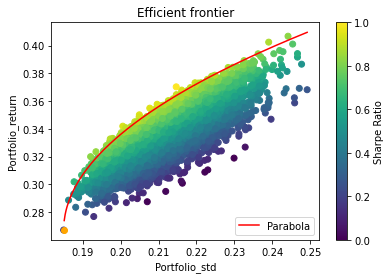

In [ ]:
#Plotting Efficient frontier
plt.scatter(stds, returns,c=sr, cmap='viridis')
plt.scatter(min(stds),returns[stds.index(min(stds))], c="orange" )
plt.title("Efficient frontier")
plt.xlabel("Portfolio_std")
plt.ylabel("Portfolio_return")
plt.colorbar(label='Sharpe Ratio')

x = np.linspace(0, max(stds), 1000)
y = parabola(x,0.079, min(stds), returns[stds.index(min(stds))])
plt.plot(x, y, label='Parabola', c= 'r')  
plt.legend(loc='lower right') 

plt.show()

In [ ]:
minstd_weights = w[stds.index(min(stds))]

### Task 5: Use a risk-free rate of 5% and plot the Security Market Line (SML). Demonstrate a few underpriced and overpriced securities. 

In [ ]:
log_return['mean_row'] = log_return.mean(axis = 1)

In [ ]:
def beta_stocks_1(lr):
    return lr.cov().iloc[0,1]/(lr['mean_row'].var())

In [ ]:
beta_stock = []

for feature in log_return:
    lr = log_return[[feature,'mean_row']]
    beta_stock.append(beta_stocks_1(lr))

In [ ]:
def SML_1(rf,rm,label):
    betas = [x/10 for x in range(21)]
    assetReturns = [rf+(rm-rf)*x for x in betas]
    plt.plot(betas,assetReturns,label=label)
    plt.xlabel("Asset Beta")
    plt.ylabel("Asset Return")
    plt.plot(1,rm,"ro")

C:\Users\santosh2\AppData\Local\Temp/ipykernel_9076/3318223335.py:3: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(beta_stock[1],log_return[log_return.columns[i]].mean()*252,"ro", color='g')


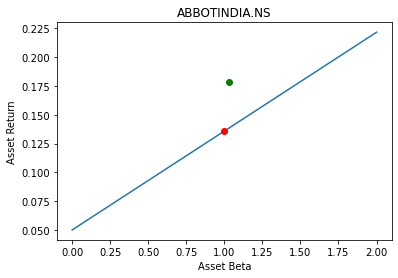

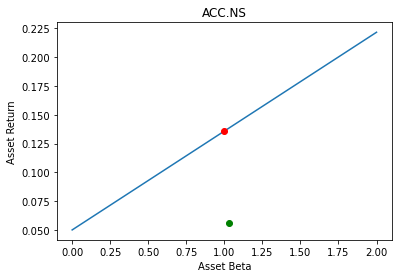

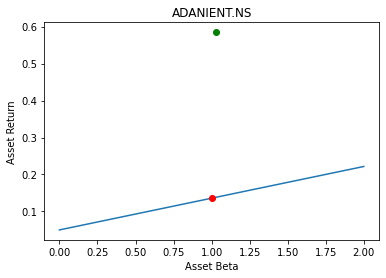

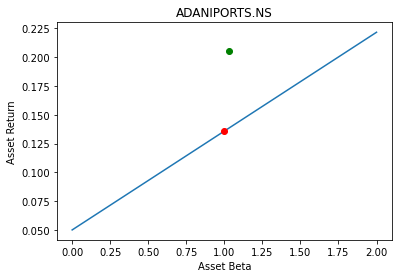

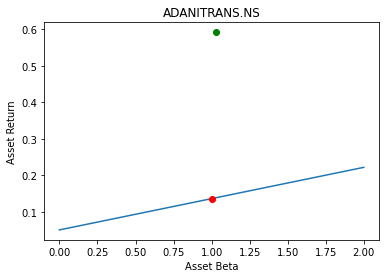

...

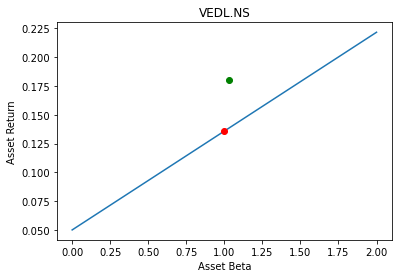

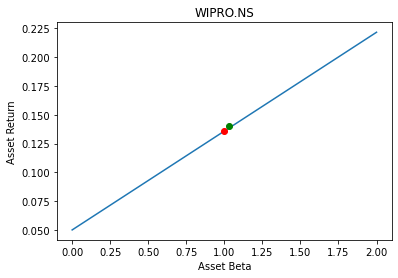

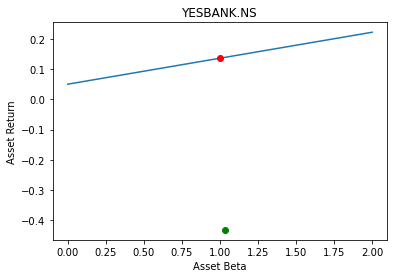

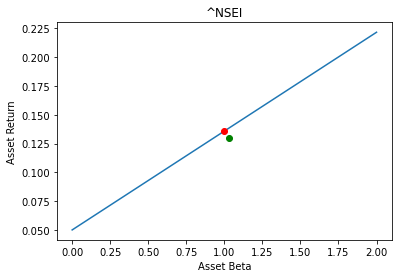

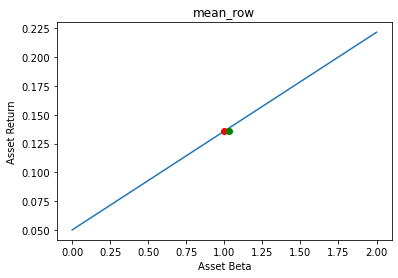

In [ ]:
for i in range(len(log_return.columns)):
    SML_1(.05,log_return['mean_row'].mean()*252,log_return[log_return.columns[i]])
    plt.plot(beta_stock[1],log_return[log_return.columns[i]].mean()*252,"ro", color='g')
    plt.title(log_return.columns[i])
    plt.show()

In [ ]:
log_return = log_return.drop('mean_row', axis =1)

### Task 6: Read about at least one other approach to estimate variance-covariance matrix and implement the same.

We are taking Nifty50 values as market return

In [ ]:
def beta_stocks_2(lr):
    return lr.cov().iloc[0,1]/(lr['^NSEI'].var())

In [ ]:
beta_stock = []

for feature in log_return:
    lr = log_return[[feature,'^NSEI']]
    beta_stock.append(beta_stocks_2(lr))

In [ ]:
def SML_2(rf,rm,label):
    betas = [x/10 for x in range(21)]
    assetReturns = [rf+(rm-rf)*x for x in betas]
    plt.plot(betas,assetReturns,label=label)
    plt.xlabel("Asset Beta")
    plt.ylabel("Asset Return")
    plt.plot(1,rm,"ro")

C:\Users\santosh2\AppData\Local\Temp/ipykernel_9076/1185405284.py:3: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(beta_stock[1],log_return[log_return.columns[i]].mean()*252,"ro", color='g')


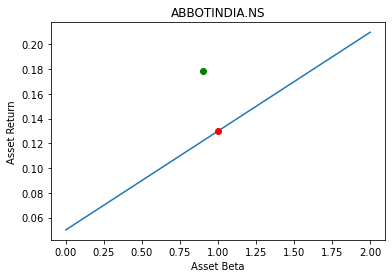

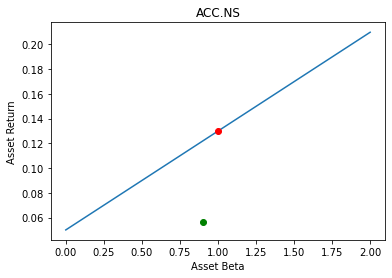

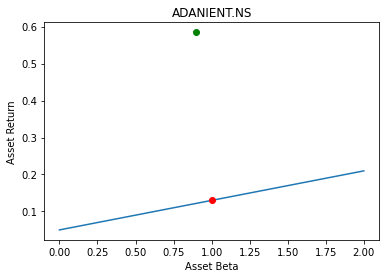

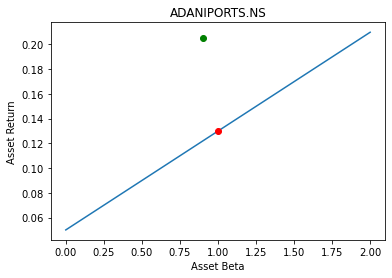

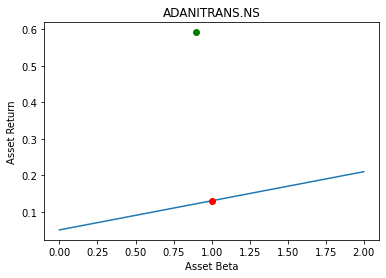

...

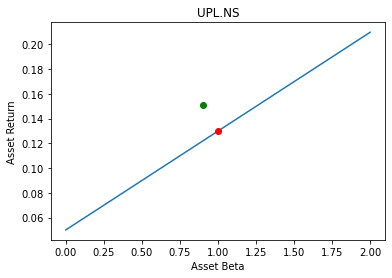

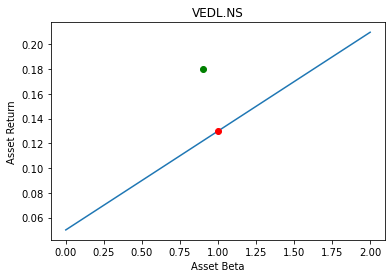

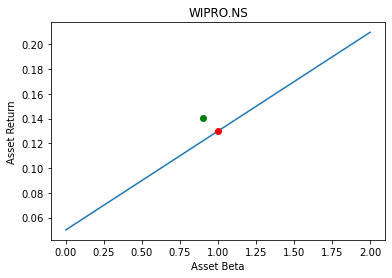

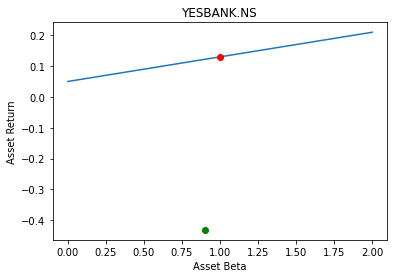

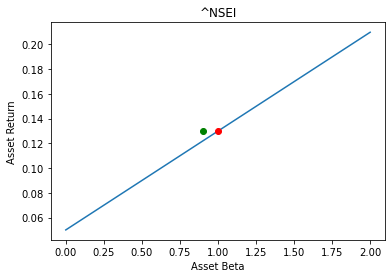

In [ ]:
for i in range(len(log_return.columns)):
    SML_2(0.05,log_return['^NSEI'].mean()*252,log_return[log_return.columns[i]])
    plt.plot(beta_stock[1],log_return[log_return.columns[i]].mean()*252,"ro", color='g')
    plt.title(log_return.columns[i])
    plt.show()

### Task 7: For the actual return distribution that you have observed, identify the suitable return, and risk measure and highlight how those should be considered in the portfolio weight identification

In [ ]:
equal_weights = [1/15]*15

In [ ]:
print("Portfolio return with equal distribution of weights: ",portfolio_return(equal_weights))

Portfolio return with equal distribution of weights:  0.3371036491289451


In [ ]:
print("Portfolio risk with equal distribution of weights: ",portfolio_std(equal_weights))

Portfolio risk with equal distribution of weights:  0.2073820671679175


In [ ]:
print("Portfolio weights with Markowitz distribution of weights: ",minstd_weights)

Portfolio weights with Markowitz distribution of weights:  [0.00065112 0.0030564  0.00294423 0.06751592 0.13721499 0.01449758
 0.03893682 0.09127442 0.18317277 0.0224306  0.12921744 0.07226634
 0.14561193 0.05145076 0.03975868]


In [ ]:
print("Portfolio return with Markowitz distribution of weights: ",portfolio_return(minstd_weights))

Portfolio return with Markowitz distribution of weights:  0.2671327935026471


In [ ]:
print("Portfolio risk with Markowitz distribution of weights: ",portfolio_std(minstd_weights))

Portfolio risk with Markowitz distribution of weights:  0.18496725320297794


In [ ]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

In [ ]:
suitable_return = 0.36

In [ ]:
print("Risk Measure for suitable return: ",stds[returns.index(find_nearest(returns, suitable_return))])
print("Sharpe ratio for suitable return: ",sr[returns.index(find_nearest(returns, suitable_return))])
print("Weight identification for suitable return:",w[returns.index(find_nearest(returns, suitable_return))])

Risk Measure for suitable return:  0.22055073629570196
Sharpe ratio for suitable return:  1.6322781429235318
Weight identification for suitable return: [0.08170694 0.09918485 0.07640442 0.09871594 0.06991543 0.03873753
 0.09978438 0.01932473 0.03076647 0.09139935 0.02232847 0.06459919
 0.0684816  0.0862736  0.05237712]
